# Group Assignment: Prediction Model



# Steps:
1. EDA
2. Image resizing (most likely into squares)
3. Normalization
- if we want to grayscale images or not
- if pixel is black = 0, white = 1
- if colour matters - RGB - 0 = black, 1 = R,G,B
4. image augmentation - flipping, cropping, blurring
5. model design
- determine how many layers we want
- filter size, stride, padding, pooling
- explain why we chose each of them
- many layers = deep learning, more time to train, more accurate
- fewer layers = shallow, less time to train, less accurate
- optimization routine
- choose loss function
- and then we'll have the metric of accuracy that we want to evaluate
6. train the model
- choose batch sizes, number of epochs - can use gridsearchcv
7. model evaluation
- training loss, accuracy, precision
- plot confusion matrix
-classification report






### Possible opensource models:
- ResNet50 - an image classification model trained off dataset of 1 million different objects
- EfficientNetB0 - also trained on imagenet database


***
## Import Libraries

In [ ]:
import io
import os
import shutil
import zipfile
import warnings
warnings.filterwarnings('ignore')

import tensorflow as tf
import math
import random
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import cv2

from PIL import Image
from tqdm import tqdm
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout, Activation, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam, Nadam, RMSprop, Adagrad, Lion
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.regularizers import l1, l2, l1_l2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.utils import to_categorical, plot_model
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score,recall_score, f1_score
from sklearn.utils import shuffle
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

In [ ]:
print('Tensorflow Version:', tf.__version__)

Tensorflow Version: 2.15.0


In [ ]:
from google.colab import drive

drive.mount('/content/drive/')
shutil.copy('/content/drive/My Drive/intel-image-classification.zip', '/content/')
with zipfile.ZipFile("/content/intel-image-classification.zip", 'r') as zip_ref:
    zip_ref.extractall("/content/")

print('Content loaded.')

Mounted at /content/drive/
Content loaded.


***
# Import Dataset

In [ ]:
IMAGE_SIZE = (150,150)

class_names = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']
class_names_labels = {class_name:i for i, class_name in enumerate(class_names)}
class_names_labels

{'buildings': 0,
 'forest': 1,
 'glacier': 2,
 'mountain': 3,
 'sea': 4,
 'street': 5}

In [ ]:
# this is much faster than the above and added a sampling parameter to allow us to determine the size of the data that we want to work with

# train_path = '/content/intel-image-classification/seg_train/'
# test_path = '/content/intel-image-classification/seg_test/'

# Angie local paths
train_path = 'Desktop/intel-image-classification/seg_train/'
test_path = 'Desktop/intel-image-classification/seg_test/'

def load_data(dataset, size=1): # default sample is full dataset
    """
        Load the data:
            - 14,034 images to train the network.
            - 3,000 images to evaluate how accurately the network learned to classify images.
    """
    images = []
    labels = []

    print("Loading {}".format(dataset))

    # Iterate through each folder corresponding to a category
    for folder in os.listdir(dataset):

        label = class_names_labels[folder]

        # for sample calculations
        folder_path = os.path.join(dataset, folder)
        files_in_folder = os.listdir(folder_path)

        sample = math.floor(len(files_in_folder) * size) + 1 # round down to nearest int and + 1 to include all data in slice for full pop

        # Iterate through each image in our folder
        for file in tqdm(files_in_folder[:sample]):

            # Get the path name of the image
            img_path = os.path.join(folder_path, file)

            # Open and resize the img
            image = cv2.imread(img_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # RGB is required for Keras, Tensorflow, Matplotlib
            image = cv2.resize(image, IMAGE_SIZE)

            # Append the image and its corresponding label to the output
            images.append(image)
            labels.append(label)

    return (np.array(images), np.array(labels))

In [ ]:
X_train, y_train = load_data(train_path)

In [ ]:
X_test, y_test = load_data(test_path)

Loading Desktop/intel-image-classification/seg_test/


100%|███████████████████████████████████████| 510/510 [00:00<00:00, 3025.99it/s]


### Split Subset of Training Data for Validation

In [ ]:
# Define paths
# train_dir = '/content/intel-image-classification/seg_train/'
# val_dir = '/content/intel-image-classification/seg_val/'

# Define paths - Angie local
train_dir = 'Desktop/intel-image-classification/seg_train/'
val_dir = 'Desktop/intel-image-classification/seg_val/'

split_ratio = 0.2

# Create validation directory if it doesn't exist
os.makedirs(val_dir, exist_ok=True)

# Get the list of classes
classes = os.listdir(train_dir)

# Iterate over each class
for class_name in classes:
    class_dir_train = os.path.join(train_dir, class_name)
    class_dir_val = os.path.join(val_dir, class_name)

    # Create class directory in the validation directory
    os.makedirs(class_dir_val, exist_ok=True)

    # Get list of images in the class directory
    images = os.listdir(class_dir_train)

    # Calculate the number of images to move to validation set
    num_val_images = int(len(images) * split_ratio)

    # Randomly select images for validation set
    val_images = random.sample(images, num_val_images)

    # Move selected images to validation directory
    for img in val_images:
        src_path = os.path.join(class_dir_train, img)
        dest_path = os.path.join(class_dir_val, img)
        shutil.move(src_path, dest_path)

print("Validation data split completed successfully.")

Validation data split completed successfully.


***
# Exploratory Data Analysis (EDA)

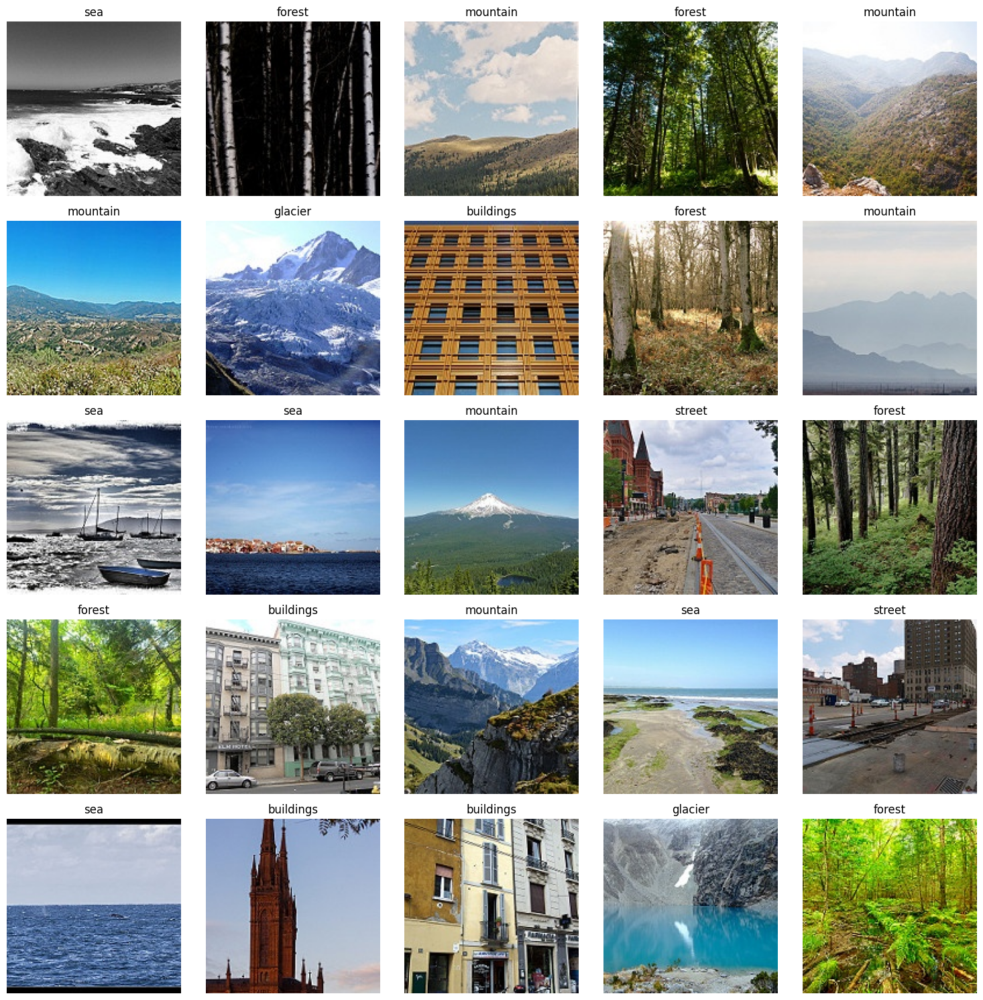

In [ ]:
# checking shuffled images to make sure labels are good

fig, ax = plt.subplots(5,5, figsize=(15, 15))

ax = ax.flatten()

for i, (img, label) in enumerate(zip(X_train[:25], y_train[:25])):
  ax[i].imshow(img)
  ax[i].set_title(f'{class_names[label]}')
  ax[i].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
X_train.shape

(14034, 150, 150, 3)

The training data contains 14,034 images, each represented as 150 x 150 pixels, with 3 color channels (RGB).

In [ ]:
len(y_train)

14034

There are 14,034 labels in the training set.

In [ ]:
y_train

array([4, 1, 3, ..., 1, 2, 3])

In [ ]:
# just experimenting with different image sizes

# IMAGE_SIZE = (150, 150)
# test = cv2.resize(train_images[10000], IMAGE_SIZE)
# plt.imshow(test.astype('uint8'))
# plt.axis('off')
# plt.show()


Each label is an integer between 0 and 5, which was mapped in an earlier step to the corresponding semantic label. This mapping is stored in a dictionary called 'class_names'.

In [ ]:
# sample first 10 images from training set
for i in range(10):
  test_image = X_train[i]

  # check the min/max pixel values
  min_pixel_value = np.min(test_image)
  max_pixel_value = np.max(test_image)

  print(f'Image {i}: [{min_pixel_value}, {max_pixel_value}]')

Image 0: [0, 255]
Image 1: [0, 255]
Image 2: [0, 255]
Image 3: [0, 255]
Image 4: [0, 255]
Image 5: [0, 255]
Image 6: [0, 255]
Image 7: [0, 255]
Image 8: [0, 150]
Image 9: [0, 255]


The images have a uniform aspect ratio, with pixel values ranging from [0, 255].

In [ ]:
# check distribution of train and test counts for each label
train_counts = {}
for label in y_train:
  train_counts[label] = train_counts.get(label, 0) + 1
print("train counts: ", train_counts)

test_counts = {}
for label in y_test:
  test_counts[label] = test_counts.get(label, 0) + 1
print("test_counts: ", test_counts)

train counts:  {4: 2274, 1: 2271, 3: 2512, 2: 2404, 0: 2191, 5: 2382}
test_counts:  {2: 553, 4: 510, 3: 525, 0: 437, 5: 501, 1: 474}


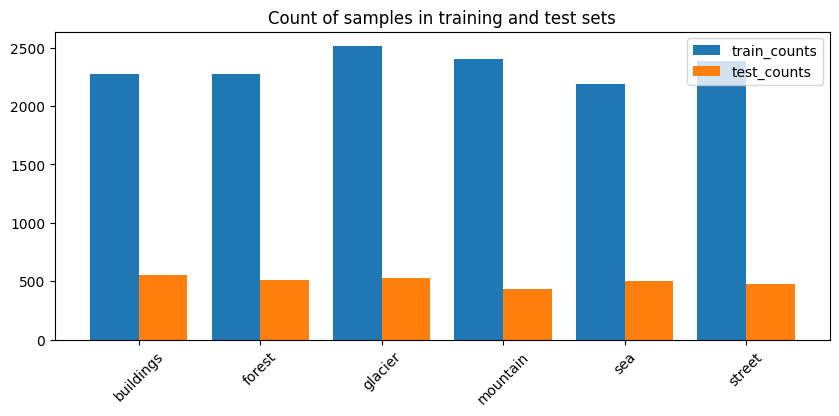

In [ ]:
# plot distributions
plt.figure(figsize=(10,4))
width=0.4

x = np.array(list(class_names_labels.values()))

y1 = train_counts.values()
y2 = test_counts.values()

plt.bar(x-0.2, y1, width, label="train_counts")
plt.bar(x+0.2, y2, width, label="test_counts")
plt.legend()
plt.title('Count of samples in training and test sets')
plt.xticks(x, class_names_labels.keys())
plt.xticks(rotation=45)
plt.show()

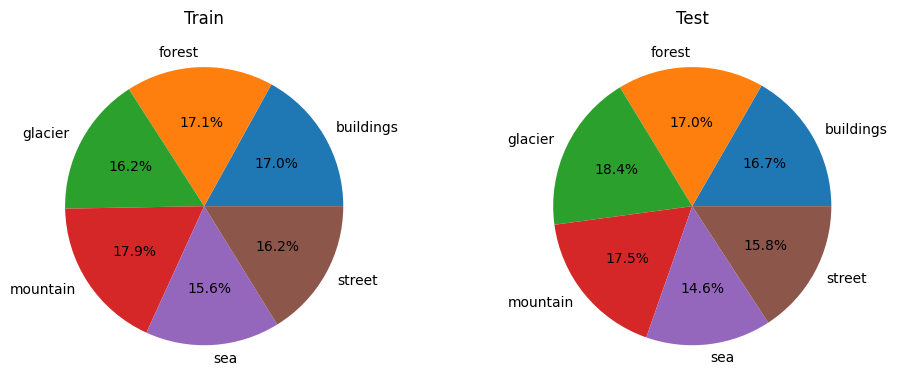

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].pie(y1, labels=class_names, autopct='%1.1f%%')
ax[0].set_title("Train")

ax[1].pie(y2, labels=class_names, autopct = '%1.1f%%')
ax[1].set_title("Test")

plt.tight_layout()
plt.show()

The distributions are pretty even between classes, so we do not have to worry about biases during the model training due to class imbalance.

### Image Visualization Using Randomization

Let's use randomization to display some images from each class in order to get a sense of variations in the dataset, which can help us identify potential challenges and address them during the preprocessing phase.

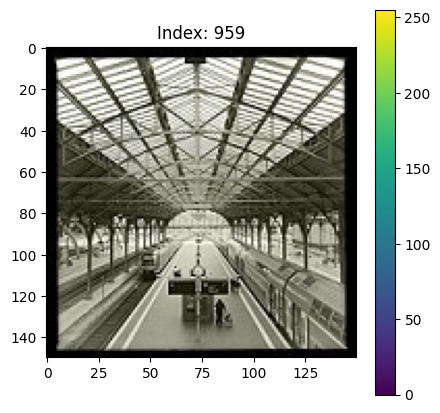

In [ ]:
# Randomly select a single image from the training set to display
plt.figure(figsize=(5,5))
rand_img = np.random.randint(0, len(X_train)-1)
plt.imshow(X_train[rand_img])
plt.colorbar()
plt.grid(False)
plt.title(f'Index: {rand_img}')
plt.show()


It's difficult to make observations when looking at one image at a time. Let's plot some more and compare them.

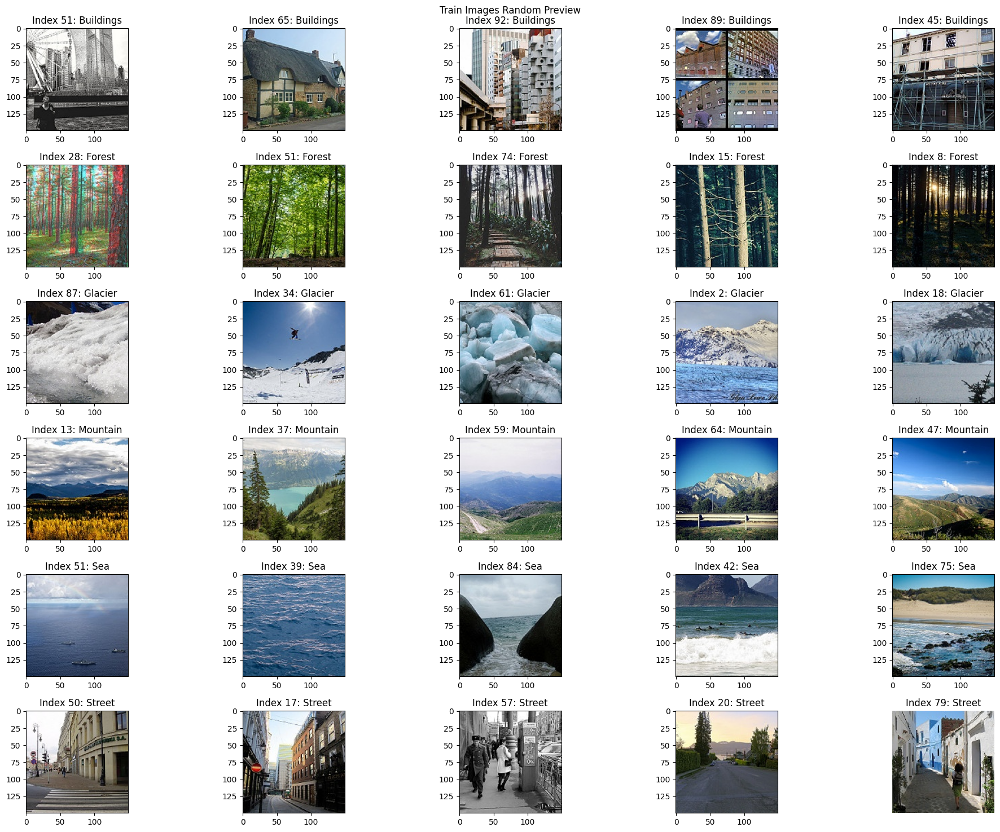

In [ ]:
# Configure plot
plt.rcParams["figure.figsize"] = (20, 15)
fig, axs = plt.subplots(6, 5)

# Display 5 random images from each category
random_state = 42
categories = ['Buildings', 'Forest', 'Glacier', 'Mountain', 'Sea', 'Street']

for i, (category, category_imgs) in enumerate(zip(categories, [buildings_img, forest_img, glacier_img, mountain_img, sea_img, street_img])):
    for j in range(5):
        rand_img = np.random.randint(0, len(category_imgs)-1)
        axs[i, j].imshow(category_imgs[rand_img])
        axs[i, j].axis('on')  # Use 'on' to hide axes
        axs[i, j].set_title(f'Index {rand_img}: {category}')  # Add a title for each image in the column

plt.suptitle('Train Images Random Preview')
plt.axis('off')
plt.tight_layout()
plt.show()

We can draw the following observations from inspecting the dataset:

* There is a mix of both grayscale and colour images
* There is some variation in lighting between images, with some darker than others
* Similarly, there is variation in lighting exposure (e.g., light flares present in # 66)
* Some images contain animate subjects, like people and animals. These other subjects may be in the foreground or background
* The borders may be ill-defined on some images (e.g., #62, #55)
* There is little variation between images in terms of orientation, and they all appear to be straight
* There is some variation in the how distant the subjects of the target classes appear in photos (e.g., #34 is a skyline of buildings, while the other sampled images are closer to the viewport)
* There is some variation in image resolution (e.g., #62, #68 and #66 are lower in resolution than others)



## t-SNE Visualization of Features

In [ ]:
display(X_train.shape)

# flatten image vector
X_train_flat = X_train.reshape(X_train.shape[0], -1) # reshape to (n_samples, n_features)
X_train_flat.shape

(14034, 150, 150, 3)

(14034, 67500)

In [ ]:
# prepare data by scaling
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X_train_flat)
X_scaled

array([[0.47058824, 0.53333333, 0.66666667, ..., 0.61176471, 0.54509804,
        0.4745098 ],
       [0.01568627, 0.01960784, 0.        , ..., 0.02352941, 0.00784314,
        0.        ],
       [0.63921569, 0.67843137, 0.71764706, ..., 0.71372549, 0.6627451 ,
        0.59607843],
       ...,
       [0.24705882, 0.28235294, 0.34117647, ..., 0.74509804, 0.74509804,
        0.75294118],
       [0.58431373, 0.58431373, 0.61568627, ..., 0.07058824, 0.07058824,
        0.07058824],
       [0.65098039, 0.85882353, 0.98431373, ..., 0.00784314, 0.03137255,
        0.01568627]])

In [ ]:
# dimensionality reduction using t-SNE
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_scaled)

# map integer values in y to class names
class_names = {v: k for k, v in class_names_labels.items()}
y_train_names = [class_names[label] for label in y_train]

In [ ]:
# plot the data
fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=y_train_names)
fig.update_layout(
    title="t-SNE visualization of the Intel Images Dataset",
    xaxis_title="X",
    yaxis_title="y",
    height=1000,
    margin=dict(r=100)
)
fig.show()

***
# Data Transformations

## 1) Create Pipelines for Transformations on Training/Testing Data

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define constants
IMAGE_SIZE = (150, 150)
BATCH_SIZE = 32

# Training/testing paths
# train_path = '/content/intel-image-classification/seg_train/'
# val_path = '/content/intel-image-classification/seg_val/'
# test_path = '/content/intel-image-classification/seg_test/'

# Training/testing paths - Angie local
train_path = 'Desktop/intel-image-classification/seg_train/'
val_path = 'Desktop/intel-image-classification/seg_val/'
test_path = 'Desktop/intel-image-classification/seg_test/'

# Define image data generator for resizing and augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,             # Rescale pixel values to [0, 1]
    rotation_range=20,          # Random rotation up to 20 degrees
    width_shift_range=0.2,      # Random horizontal shift by up to 20% of the width
    height_shift_range=0.2,     # Random vertical shift by up to 20% of the height
    shear_range=0.2,            # Shear intensity
    zoom_range=0.2,             # Random zoom up to 20%
    horizontal_flip=True,       # Random horizontal flipping
    fill_mode='nearest'         # Fill mode for filling in newly created pixels
)

# Load training data using flow_from_directory and apply resizing and augmentation
train_generator = train_datagen.flow_from_directory(
    directory=train_path,               # Path to training data directory
    target_size=IMAGE_SIZE,             # Resize images to IMAGE_SIZE
    batch_size=BATCH_SIZE,              # Batch size
    class_mode='categorical',           # Classification mode
    shuffle=True                        # Shuffle training data
)

# Load validation data using flow_from_directory and apply resizing and augmentation
val_generator = train_datagen.flow_from_directory(
    directory=val_path,                 # Path to validation data directory
    target_size=IMAGE_SIZE,             # Resize images to IMAGE_SIZE
    batch_size=BATCH_SIZE,              # Batch size
    class_mode='categorical',           # Classification mode
    shuffle=True                        # Shuffle validation data
)

# Load test data without augmentation
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    directory=test_path,                # Path to test data directory
    target_size=IMAGE_SIZE,             # Resize images to IMAGE_SIZE
    batch_size=BATCH_SIZE,              # Batch size
    class_mode='categorical'            # Classification mode
)

Found 3687 images belonging to 6 classes.
Found 10347 images belonging to 6 classes.
Found 3000 images belonging to 6 classes.


## 2) Perform Transformations on Batch of Data and Randomly Display 25 Images

TRANSFORMED TRAINING IMAGES


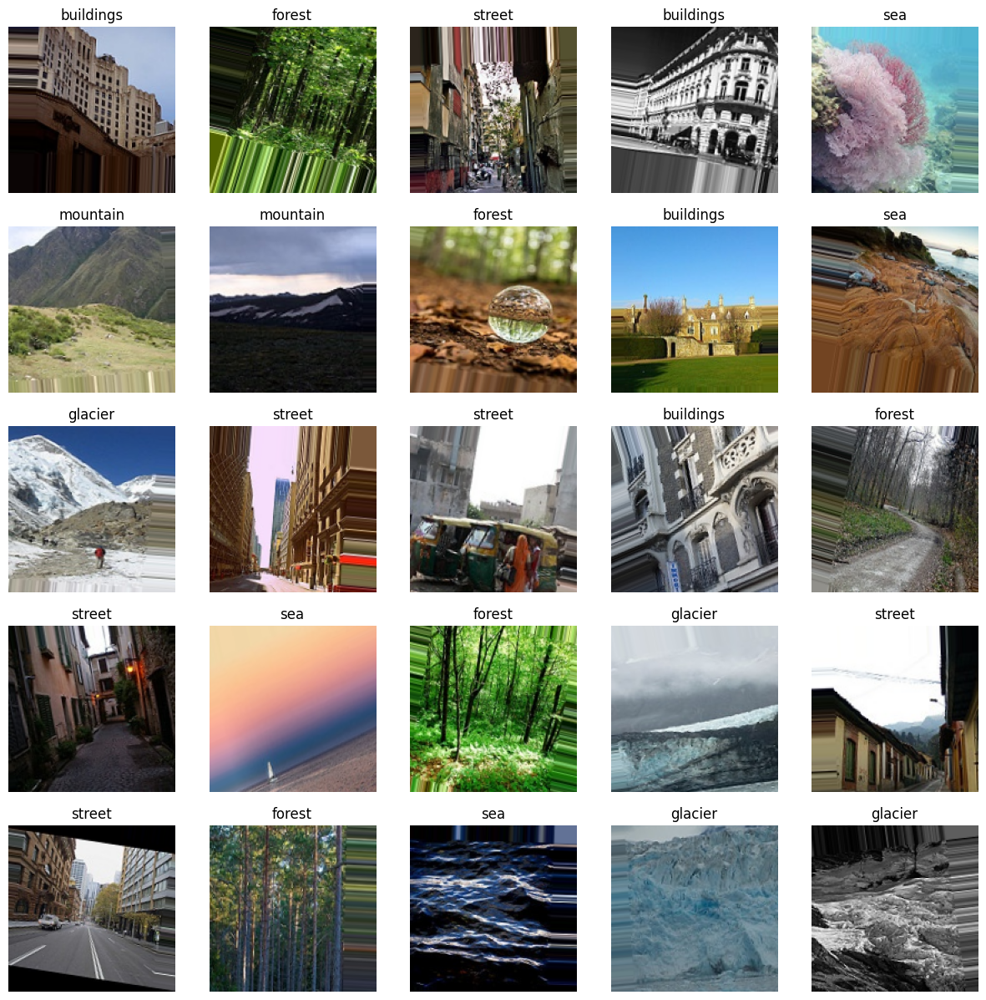

TRANSFORMED TESTING IMAGES


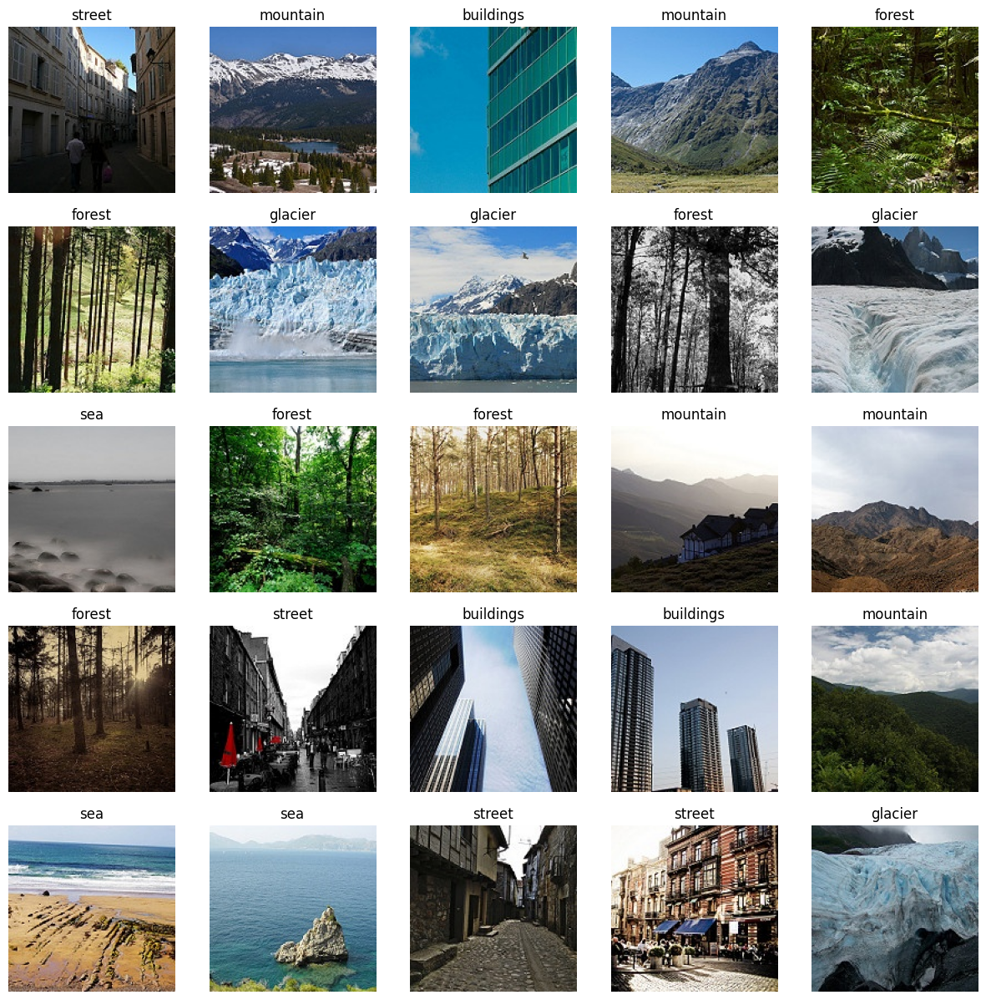

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Function to display images in a subplot
def display_images(images, titles, rows, cols):
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i])
        ax.set_title(titles[i])
        ax.axis('off')
    plt.show()

# Get a batch of training and test data
x_train_batch, y_train_batch = next(train_generator)
x_test_batch, y_test_batch = next(val_generator)

# Randomly select 25 training and 25 test images
train_indices = np.random.choice(range(len(x_train_batch)), size=25, replace=False)
test_indices = np.random.choice(range(len(x_test_batch)), size=25, replace=False)

# Extract the selected images and labels
train_images = x_train_batch[train_indices]
train_labels = y_train_batch[train_indices]
test_images = x_test_batch[test_indices]
test_labels = y_test_batch[test_indices]

# Get class labels
class_labels = train_generator.class_indices

# Convert one-hot encoded labels to class names
train_labels = np.argmax(train_labels, axis=1)
test_labels = np.argmax(test_labels, axis=1)
train_labels = [list(class_labels.keys())[list(class_labels.values()).index(label)] for label in train_labels]
test_labels = [list(class_labels.keys())[list(class_labels.values()).index(label)] for label in test_labels]

# Display 25 training images
print("TRANSFORMED TRAINING IMAGES")
display_images(train_images, train_labels, rows=5, cols=5)

# Display 25 test images
print("TRANSFORMED TESTING IMAGES")
display_images(test_images, test_labels, rows=5, cols=5)

# Create Baseline Model Without Transformations

Let's start by applying normalization to the pixel values to a range of [0,1], then build a simple model to establish a baseline before proceeding with further optimizations.

First, we'll shuffle the data to mitigate the risk of overfitting.

In [ ]:
# shuffle and normalize the data
X_train, y_train = shuffle(X_train, y_train, random_state=123)

X_train_norm = X_train / 255
X_test_norm = X_test / 255

In [ ]:
print(f"X_train_norm shape {X_train_norm.shape}")
print(f"y_train shape {y_train.shape}")
print(f"X_test shape {X_test.shape}")
print(f"y_test shape {y_test.shape}")

X_train_norm shape (4606, 150, 150, 3)
y_train shape (4606,)
X_test shape (3000, 150, 150, 3)
y_test shape (3000,)


In [ ]:
# this is a simple model to be used as a baseline
simple_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    MaxPool2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPool2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPool2D((2, 2)),
    Flatten(),
    Dense(1024, activation='relu'),
    Dense(512, activation='relu'),
    Dense(256, activation='relu'),
    Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
])

In [ ]:
# compile the model
simple_model.compile(
    optimizer='adam', # standard learning rate
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
simple_model_history = simple_model.fit(
    X_train_norm,
    y_train,
    batch_size=32,
    validation_split=0.2,
    epochs=10
)

Epoch 1/10
351/351 [==============================] - 11s 26ms/step - loss: 1.0427 - accuracy: 0.5880 - val_loss: 0.8292 - val_accuracy: 0.6669
Epoch 2/10
351/351 [==============================] - 6s 17ms/step - loss: 0.7014 - accuracy: 0.7412 - val_loss: 0.6145 - val_accuracy: 0.7770
Epoch 3/10
351/351 [==============================] - 6s 17ms/step - loss: 0.5085 - accuracy: 0.8152 - val_loss: 0.5879 - val_accuracy: 0.7937
Epoch 4/10
351/351 [==============================] - 6s 17ms/step - loss: 0.3740 - accuracy: 0.8642 - val_loss: 0.6359 - val_accuracy: 0.7976
Epoch 5/10
351/351 [==============================] - 6s 17ms/step - loss: 0.2459 - accuracy: 0.9143 - val_loss: 0.7540 - val_accuracy: 0.7691
Epoch 6/10
351/351 [==============================] - 6s 17ms/step - loss: 0.1595 - accuracy: 0.9462 - val_loss: 0.7094 - val_accuracy: 0.8069
Epoch 7/10
351/351 [==============================] - 6s 17ms/step - loss: 0.0988 - accuracy: 0.9689 - val_loss: 1.1855 - val_accuracy: 0.783

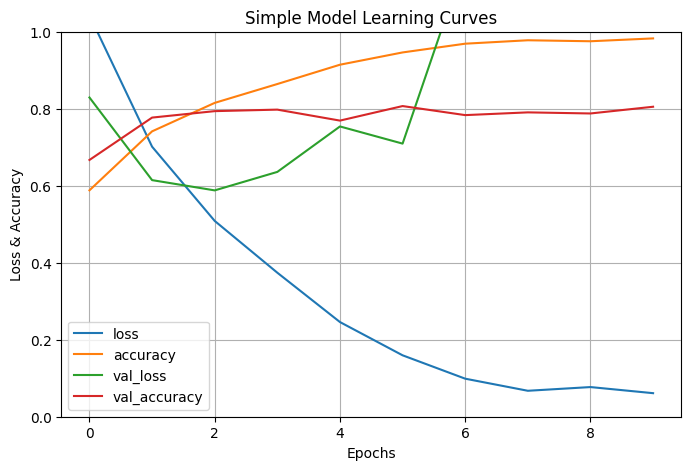

In [ ]:
# plot the learning rate
pd.DataFrame(simple_model_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.title('Simple Model Learning Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss & Accuracy')
plt.show()

We can see the model starts overfitting pretty quickly

### Lowering the Learning Rate

In [ ]:
# compile the model
simple_model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
simple_model_history = simple_model.fit(
    X_train_norm,
    y_train,
    batch_size=32,
    validation_split=0.2,
    epochs=10
)

Epoch 1/10
351/351 [==============================] - 14s 24ms/step - loss: 1.0611 - accuracy: 0.5887 - val_loss: 0.8334 - val_accuracy: 0.6893
Epoch 2/10
351/351 [==============================] - 6s 16ms/step - loss: 0.7438 - accuracy: 0.7233 - val_loss: 0.6964 - val_accuracy: 0.7414
Epoch 3/10
351/351 [==============================] - 6s 16ms/step - loss: 0.6135 - accuracy: 0.7788 - val_loss: 0.5924 - val_accuracy: 0.7791
Epoch 4/10
351/351 [==============================] - 6s 16ms/step - loss: 0.5064 - accuracy: 0.8198 - val_loss: 0.5648 - val_accuracy: 0.7952
Epoch 5/10
351/351 [==============================] - 6s 16ms/step - loss: 0.4370 - accuracy: 0.8445 - val_loss: 0.5292 - val_accuracy: 0.8044
Epoch 6/10
351/351 [==============================] - 6s 16ms/step - loss: 0.3515 - accuracy: 0.8798 - val_loss: 0.5582 - val_accuracy: 0.8080
Epoch 7/10
351/351 [==============================] - 6s 16ms/step - loss: 0.2639 - accuracy: 0.9106 - val_loss: 0.5253 - val_accuracy: 0.815

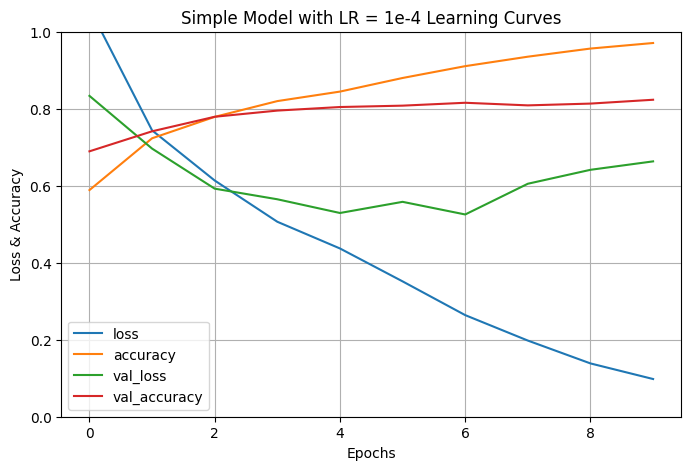

In [ ]:
# plot the learning rate
pd.DataFrame(simple_model_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.title('Simple Model with LR = 1e-4 Learning Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss & Accuracy')
plt.show()

Still overfitting, but getting better

### Evaluate Model Weaknesses

In [ ]:
# make predictions with the last version of our model (LR = 1e-4)
simple_preds = simple_model.predict(X_test_norm)
pred_labels = np.argmax(simple_preds, axis=1)
true_labels = y_test

94/94 [==============================] - 1s 5ms/step


In [ ]:
# print performance metrics
accuracy = accuracy_score(true_labels, pred_labels)
precision = precision_score(true_labels, pred_labels, average="macro")
recall = recall_score(true_labels, pred_labels, average="macro")
f1 = f1_score(true_labels, pred_labels, average="macro")

print(f'accuracy score: {accuracy}')
print(f'precision score: {precision}')
print(f'recall score: {recall}')
print(f'f1 score: {f1}')

accuracy score: 0.8136666666666666
precision score: 0.8206880594575802
recall score: 0.8134843456721326
f1 score: 0.8149589723553277


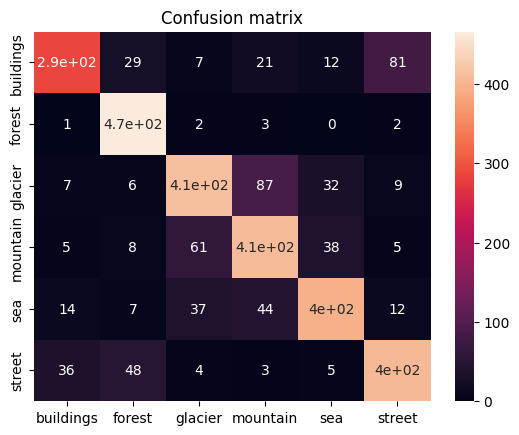

In [ ]:
CM = confusion_matrix(true_labels, pred_labels)
ax = plt.axes()
sns.heatmap(CM, annot=True,
           annot_kws={"size": 10},
           xticklabels=class_names,
           yticklabels=class_names, ax = ax)
ax.set_title('Confusion matrix')
plt.show()

- Forests are predicted pretty accurately
- Buildings are missed quite a bit
- Glaciers, mountains, and sea are often confused

# Create Model Using Augmented Data

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True, verbose=1)

# define model checkpoint
model_checkpoint = ModelCheckpoint(
    'best_model_simple_transf.h5',
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose=1
    )

In [ ]:
# compile the model
simple_model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy', # sparse throws error with the transformed data - ABR
    metrics=['accuracy']
)

In [ ]:
# train model and store history
simple_model_transf_history = simple_model.fit(
    x=train_generator,
    validation_data=val_generator,
    epochs=50,
    callbacks=[early_stopping, model_checkpoint],
    verbose=1
    )

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 0.3987 - accuracy: 0.8541
Epoch 1: val_loss improved from inf to 0.47122, saving model to best_model_simple_transf.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 67s 185ms/step - loss: 0.3987 - accuracy: 0.8541 - val_loss: 0.4712 - val_accuracy: 0.8310
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.3987 - accuracy: 0.8531
Epoch 2: val_loss improved from 0.47122 to 0.43844, saving model to best_model_simple_transf.h5
351/351 [==============================] - 64s 183ms/step - loss: 0.3987 - accuracy: 0.8531 - val_loss: 0.4384 - val_accuracy: 0.8449
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.3848 - accuracy: 0.8571
Epoch 3: val_loss did not improve from 0.43844
351/351 [==============================] - 63s 180ms/step - loss: 0.3848 - accuracy: 0.8571 - val_loss: 0.4695 - val_accuracy: 0.8335
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.3793 - accuracy: 0.8614
Epoch 4: val_loss did not improve from 0.43844
351/351 [==============================] - 63s 179ms/step - loss: 0.3793 - accuracy: 0.8614 - val_loss: 0.5200 - val_acc

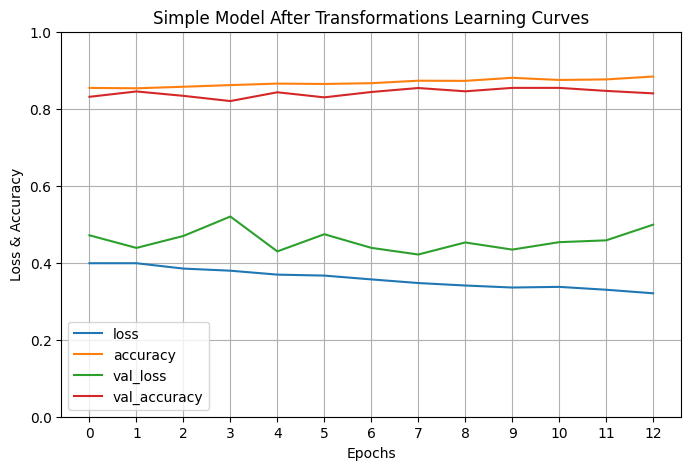

In [ ]:
# plot learning curves
pd.DataFrame(simple_model_transf_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.title('Simple Model After Transformations Learning Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss & Accuracy')
plt.xticks(range(len(simple_model_transf_history.history['loss']))) # set xticks to step by 1
plt.show()

Add confusion matrix to identify errors before proceeding to optimizations

In [ ]:
# make predictions with the augmented data model
simple_preds = simple_model.predict(X_test_norm)
pred_labels = np.argmax(simple_preds, axis=1)
true_labels = y_test

94/94 [==============================] - 1s 5ms/step


In [ ]:
# print performance metrics
accuracy = accuracy_score(true_labels, pred_labels)
precision = precision_score(true_labels, pred_labels, average="macro")
recall = recall_score(true_labels, pred_labels, average="macro")
f1 = f1_score(true_labels, pred_labels, average="macro")

print(f'accuracy score: {accuracy}')
print(f'precision score: {precision}')
print(f'recall score: {recall}')
print(f'f1 score: {f1}')

accuracy score: 0.8623333333333333
precision score: 0.8618535772459226
recall score: 0.8648374674249183
f1 score: 0.8622733554547697


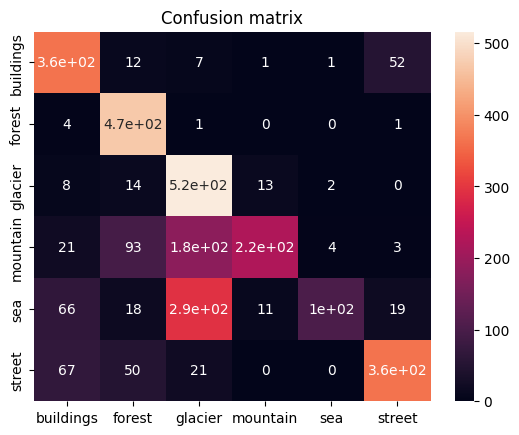

In [ ]:
CM = confusion_matrix(y_test, pred_labels)
ax = plt.axes()
sns.heatmap(CM, annot=True,
           annot_kws={"size": 10},
           xticklabels=class_names,
           yticklabels=class_names, ax = ax)
ax.set_title('Confusion matrix')
plt.show()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 74, 74, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 36, 36, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 17, 17, 128)       0

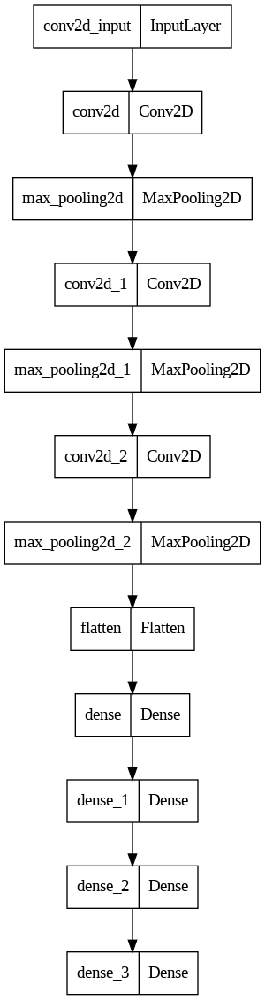

In [ ]:
# load best model
best_model_simple = load_model('best_model_simple_transf.h5')

# inspect model summary
best_model_simple.summary()
plot_model(best_model_simple, to_file='best_model_simple_plot.png')

So far, this model performs pretty well, but let's try to optimize it, starting with different activation functions.

***
# Hyperparameter Tuning

### Testing Activation functions



In the hidden layers, we'll test:
- 'softplus'
- 'elu'
- 'leaky_relu'

First, let's create a custom function to test changes to the baseline model more quickly and easily.

In [ ]:
def create_test_model(activation):

  # this is the same simple model we previously built
  model = Sequential([
      Conv2D(32, (3, 3), activation=activation, input_shape=(150, 150, 3)),
      MaxPool2D((2, 2)),
      Conv2D(64, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Conv2D(128, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Flatten(input_shape=(150,150, 3)),
      Dense(1024, activation=activation),
      Dense(512, activation=activation),
      Dense(256, activation=activation),
      Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
  ])

  # compile the model
  model.compile(
      optimizer=Adam(learning_rate=1e-4),
      loss='categorical_crossentropy',
      metrics=['accuracy']
  )

  return model



-----------------------------------------------------------------
******************** Testing elu ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.1408 - accuracy: 0.5693
Epoch 1: val_loss improved from inf to 1.26071, saving model to best_model_elu.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 67s 184ms/step - loss: 1.1408 - accuracy: 0.5693 - val_loss: 1.2607 - val_accuracy: 0.5235
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.9207 - accuracy: 0.6472
Epoch 2: val_loss improved from 1.26071 to 0.89018, saving model to best_model_elu.h5
351/351 [==============================] - 63s 180ms/step - loss: 0.9207 - accuracy: 0.6472 - val_loss: 0.8902 - val_accuracy: 0.6594
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.8465 - accuracy: 0.6800
Epoch 3: val_loss did not improve from 0.89018
351/351 [==============================] - 63s 180ms/step - loss: 0.8465 - accuracy: 0.6800 - val_loss: 0.9407 - val_accuracy: 0.6680
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.7807 - accuracy: 0.7040
Epoch 4: val_loss improved from 0.89018 to 0.71768, saving model to best_model_elu.h5
351/351 [==============================] - 64s 181ms/step - loss: 0.7807 - accuracy: 0.7040

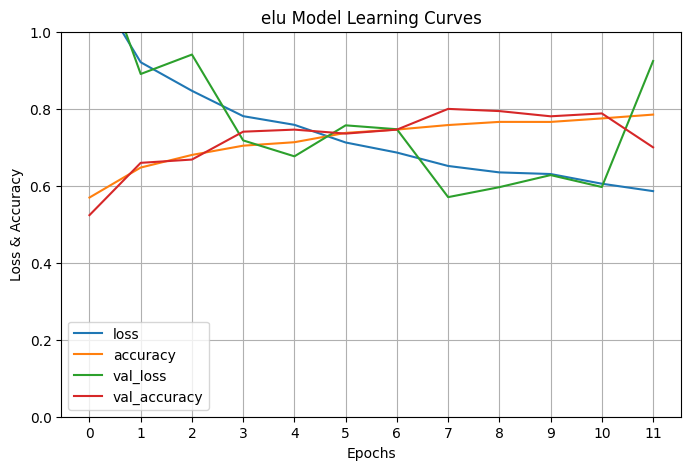


-----------------------------------------------------------------
******************** Testing leaky_relu ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.1491 - accuracy: 0.5471
Epoch 1: val_loss improved from inf to 0.91711, saving model to best_model_leaky_relu.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 66s 183ms/step - loss: 1.1491 - accuracy: 0.5471 - val_loss: 0.9171 - val_accuracy: 0.6555
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.9080 - accuracy: 0.6565
Epoch 2: val_loss improved from 0.91711 to 0.82702, saving model to best_model_leaky_relu.h5
351/351 [==============================] - 65s 185ms/step - loss: 0.9080 - accuracy: 0.6565 - val_loss: 0.8270 - val_accuracy: 0.6879
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.8254 - accuracy: 0.6901
Epoch 3: val_loss improved from 0.82702 to 0.81885, saving model to best_model_leaky_relu.h5
351/351 [==============================] - 65s 184ms/step - loss: 0.8254 - accuracy: 0.6901 - val_loss: 0.8188 - val_accuracy: 0.6933
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.7547 - accuracy: 0.7157
Epoch 4: val_loss improved from 0.81885 to 0.76807, saving model to best_model_leaky_relu.h5
351/351 [======================

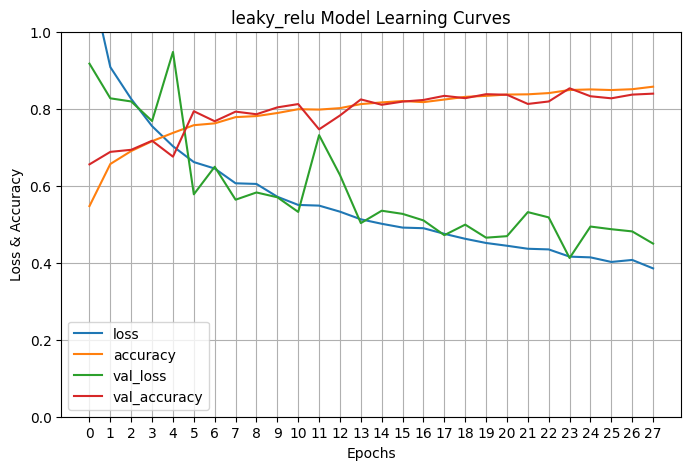


-----------------------------------------------------------------
******************** Testing softplus ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.8908 - accuracy: 0.1618
Epoch 1: val_loss improved from inf to 1.85092, saving model to best_model_softplus.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 66s 183ms/step - loss: 1.8908 - accuracy: 0.1618 - val_loss: 1.8509 - val_accuracy: 0.1712
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.6831 - accuracy: 0.2776
Epoch 2: val_loss improved from 1.85092 to 1.47830, saving model to best_model_softplus.h5
351/351 [==============================] - 64s 182ms/step - loss: 1.6831 - accuracy: 0.2776 - val_loss: 1.4783 - val_accuracy: 0.3894
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 1.4678 - accuracy: 0.4083
Epoch 3: val_loss improved from 1.47830 to 1.33091, saving model to best_model_softplus.h5
351/351 [==============================] - 64s 183ms/step - loss: 1.4678 - accuracy: 0.4083 - val_loss: 1.3309 - val_accuracy: 0.4722
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 1.4167 - accuracy: 0.4432
Epoch 4: val_loss improved from 1.33091 to 1.29467, saving model to best_model_softplus.h5
351/351 [============================

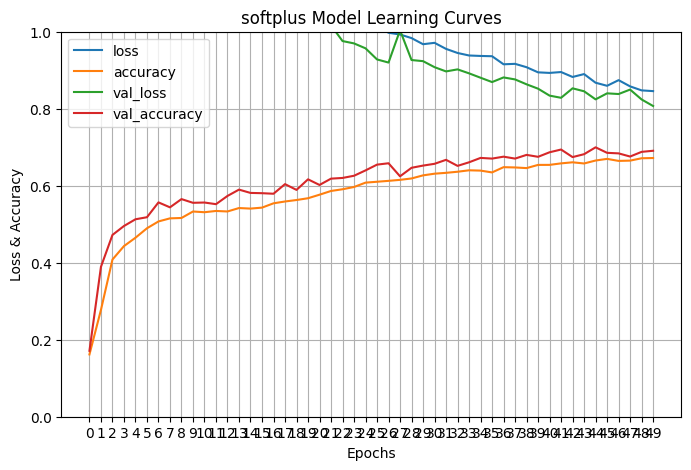

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True, verbose=1)

# stuff for printing
dashes = '-' * 65
stars = '*' * 20

# loop through different activation functions

for activation in ['elu', 'leaky_relu', 'softplus']:
  print(f'\n{dashes}\n{stars}',f'Testing {activation}',f'{stars}\n{dashes}\n')
  model = create_test_model(activation)

  # define model checkpoint
  model_checkpoint = ModelCheckpoint(f'best_model_{activation}.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)

  # train model
  model_history = model.fit(
      x=train_generator,
      validation_data=val_generator,
      epochs=50,
      callbacks=[early_stopping, model_checkpoint],
      verbose=1
      )

  # plot learning curves
  pd.DataFrame(model_history.history).plot(figsize=(8, 5))
  plt.grid(True)
  plt.gca().set_ylim(0, 1)
  plt.title(f'{activation} Model Learning Curves')
  plt.xlabel('Epochs')
  plt.ylabel('Loss & Accuracy')
  plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
  plt.show()

  # model.summary()

To recap the performance of the best models from each activation function:

ReLU:
- Training loss: 0.3997
- Training accuracy: 0.9878
- Validation loss: 0.0694
- Validation accuracy: 0.9793
- Recall that learning curves did not indicate significant overfitting by the time we reached the best model.

Softplus:
- Training loss: 0.8637
- Training accuracy: 0.6647
- Validation loss: 0.8921
- Validation accuracy: 0.6623
- Learning curves indicate convergence starts to occur by the end of the 10 epochs, however, performance is worse compared to ReLU's with less epochs, so this would not be a better option.  

eLU:
- Training loss: 0.2899
- Training accuracy: 0.8954
- Validation loss: 0.6424
- Validation accuracy: 0.7966
- Though accuracy and loss are improved over Softplus, the learning curves indicate that overfitting begins early on in training.

Leaky ReLU:
- Training loss: 0.6921
- Training accuracy: 0.7453
- Validation loss: 0.5895
- Validation accuracy: 0.7791
- Performance is similar to the eLU and ReLU functions, with overfitting occurring relatively early in epochs.

Based on these results, it seems we should stick with using 'relu' as the activation function, as the others did not significantly improve model performance.

Different activation functions have little impact on the results. Not sure why softplus was so bad. Only explanation is that it seems like it's not being applied.

### Testing Optimizers

First, we'll adapt the custom function to accept an optimizer as argument.

Then, we'll test the following optimizers:
- nadam
- rmsprop
- adagrad
- lion

In [ ]:
# create new function for testing different optimizers
def create_test_model_optz(activation, optz='adam'):

  # this is the same simple model we previously built
  model = Sequential([
      Conv2D(32, (3, 3), activation=activation, input_shape=(150, 150, 3)),
      MaxPool2D((2, 2)),
      Conv2D(64, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Conv2D(128, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Flatten(input_shape=(150,150, 3)),
      Dense(1024, activation=activation),
      Dense(512, activation=activation),
      Dense(256, activation=activation),
      Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
  ])

  if optz == 'adam':
      optz = Adam(learning_rate=1e-4)
  elif optz == 'nadam':
      optz = Nadam(learning_rate=1e-4)
  elif optz == 'rmsprop':
      optz = RMSprop(learning_rate=1e-4)
  elif optz == 'adagrad':
      optz = Adagrad(learning_rate=1e-4)
  elif optz == 'lion':
      optz = Lion(learning_rate=1e-4)

  # compile the model
  model.compile(
      optimizer=optz,
      loss='categorical_crossentropy',
      metrics=['accuracy']
  )

  return model



-----------------------------------------------------------------
******************** Testing nadam ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.1595 - accuracy: 0.5378
Epoch 1: val_loss improved from inf to 0.98001, saving model to best_model_nadam.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 82s 217ms/step - loss: 1.1595 - accuracy: 0.5378 - val_loss: 0.9800 - val_accuracy: 0.6369
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.8920 - accuracy: 0.6663
Epoch 2: val_loss improved from 0.98001 to 0.83154, saving model to best_model_nadam.h5
351/351 [==============================] - 76s 218ms/step - loss: 0.8920 - accuracy: 0.6663 - val_loss: 0.8315 - val_accuracy: 0.6858
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.8225 - accuracy: 0.6916
Epoch 3: val_loss improved from 0.83154 to 0.78528, saving model to best_model_nadam.h5
351/351 [==============================] - 76s 217ms/step - loss: 0.8225 - accuracy: 0.6916 - val_loss: 0.7853 - val_accuracy: 0.7044
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.7637 - accuracy: 0.7146
Epoch 4: val_loss improved from 0.78528 to 0.73994, saving model to best_model_nadam.h5
351/351 [==============================] - 79s

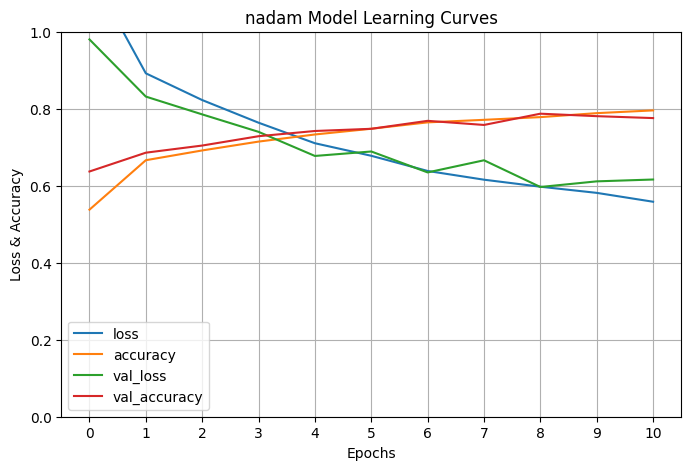


-----------------------------------------------------------------
******************** Testing rmsprop ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.2605 - accuracy: 0.4933
Epoch 1: val_loss improved from inf to 1.09130, saving model to best_model_rmsprop.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 78s 216ms/step - loss: 1.2605 - accuracy: 0.4933 - val_loss: 1.0913 - val_accuracy: 0.5777
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.0257 - accuracy: 0.6011
Epoch 2: val_loss improved from 1.09130 to 0.99969, saving model to best_model_rmsprop.h5
351/351 [==============================] - 75s 214ms/step - loss: 1.0257 - accuracy: 0.6011 - val_loss: 0.9997 - val_accuracy: 0.6234
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.9261 - accuracy: 0.6449
Epoch 3: val_loss improved from 0.99969 to 0.87694, saving model to best_model_rmsprop.h5
351/351 [==============================] - 76s 216ms/step - loss: 0.9261 - accuracy: 0.6449 - val_loss: 0.8769 - val_accuracy: 0.6669
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.8604 - accuracy: 0.6790
Epoch 4: val_loss did not improve from 0.87694
351/351 [==============================] - 74s 210ms/step - loss: 0.8604 - accuracy

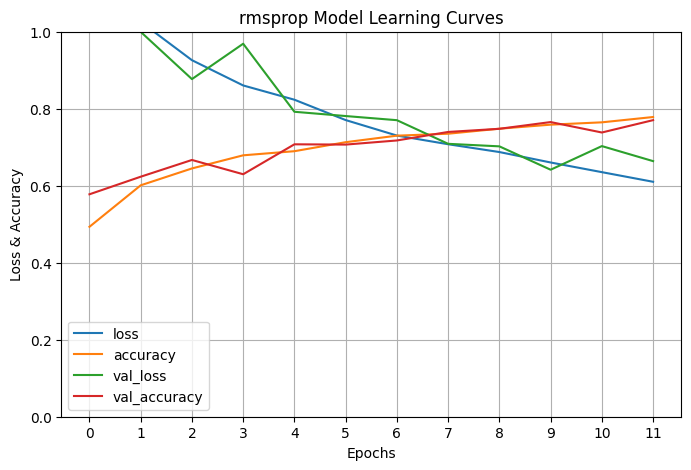


-----------------------------------------------------------------
******************** Testing adagrad ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.7829 - accuracy: 0.2185
Epoch 1: val_loss improved from inf to 1.77486, saving model to best_model_adagrad.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 78s 217ms/step - loss: 1.7829 - accuracy: 0.2185 - val_loss: 1.7749 - val_accuracy: 0.2404
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.7653 - accuracy: 0.2561
Epoch 2: val_loss improved from 1.77486 to 1.75948, saving model to best_model_adagrad.h5
351/351 [==============================] - 76s 216ms/step - loss: 1.7653 - accuracy: 0.2561 - val_loss: 1.7595 - val_accuracy: 0.2739
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 1.7472 - accuracy: 0.2862
Epoch 3: val_loss improved from 1.75948 to 1.74272, saving model to best_model_adagrad.h5
351/351 [==============================] - 76s 216ms/step - loss: 1.7472 - accuracy: 0.2862 - val_loss: 1.7427 - val_accuracy: 0.2974
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 1.7256 - accuracy: 0.3210
Epoch 4: val_loss improved from 1.74272 to 1.71982, saving model to best_model_adagrad.h5
351/351 [==============================]

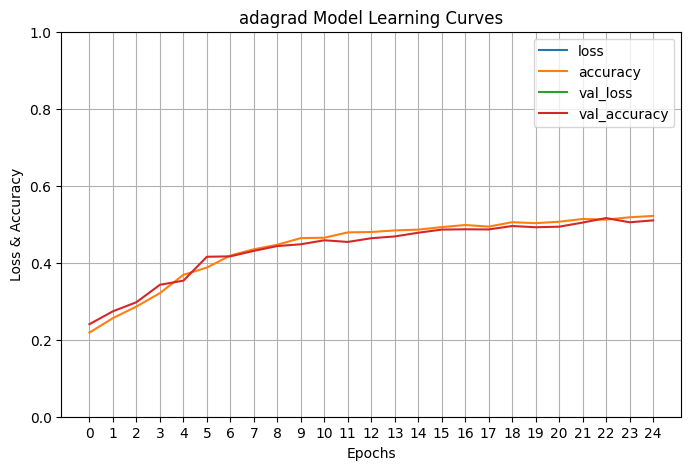


-----------------------------------------------------------------
******************** Testing lion ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.0902 - accuracy: 0.5731
Epoch 1: val_loss improved from inf to 0.87117, saving model to best_model_lion.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 77s 214ms/step - loss: 1.0902 - accuracy: 0.5731 - val_loss: 0.8712 - val_accuracy: 0.6737
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.7913 - accuracy: 0.7081
Epoch 2: val_loss improved from 0.87117 to 0.74627, saving model to best_model_lion.h5
351/351 [==============================] - 75s 214ms/step - loss: 0.7913 - accuracy: 0.7081 - val_loss: 0.7463 - val_accuracy: 0.7175
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.6803 - accuracy: 0.7442
Epoch 3: val_loss improved from 0.74627 to 0.67545, saving model to best_model_lion.h5
351/351 [==============================] - 78s 221ms/step - loss: 0.6803 - accuracy: 0.7442 - val_loss: 0.6755 - val_accuracy: 0.7564
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.6111 - accuracy: 0.7725
Epoch 4: val_loss improved from 0.67545 to 0.62964, saving model to best_model_lion.h5
351/351 [==============================] - 78s 22

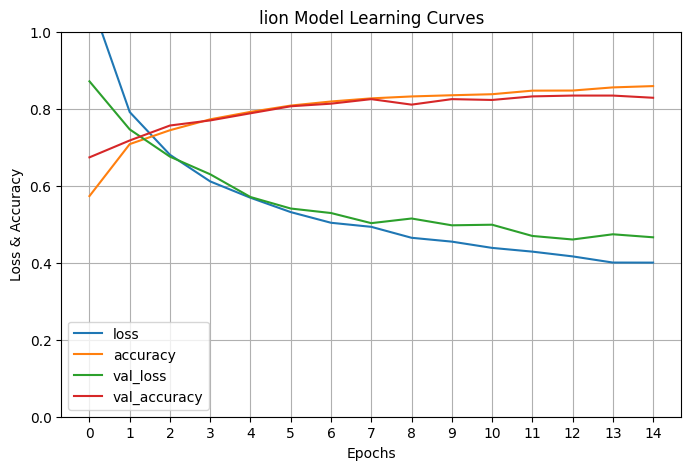

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)

# stuff for printing
dashes = '-' * 65
stars = '*' * 20

# loop through different optimizers

for optz in ['nadam', 'rmsprop', 'adagrad', 'lion']:
  print(f'\n{dashes}\n{stars}',f'Testing {optz}',f'{stars}\n{dashes}\n')
  model = create_test_model_optz('relu', optz)

  # define model checkpoint
  model_checkpoint = ModelCheckpoint(f'best_model_{optz}.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)

  # train model
  model_history = model.fit(
      x=train_generator,
      validation_data=val_generator,
      epochs=50,
      batch_size=64,
      callbacks=[early_stopping, model_checkpoint],
      verbose=1
      )

  # plot learning curves
  pd.DataFrame(model_history.history).plot(figsize=(8, 5))
  plt.grid(True)
  plt.gca().set_ylim(0, 1)
  plt.title(f'{optz} Model Learning Curves')
  plt.xlabel('Epochs')
  plt.ylabel('Loss & Accuracy')
  plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
  plt.show()

  # model.summary()

To recap the performance of the best models from each optimzer:

Adam:
- Training accuracy: 0.8728
- Training loss: 0.3472
- Validation accuracy: 0.8538
- Validation loss: 0.4213
- Best model: 8
- Recall that learning curves did not indicate significant overfitting by the time we reached the best model.


Nadam:
- Training accuracy: 0.7782
- Training loss: 0.5974
- Validation accuracy: 0.7871
- Validation loss: 0.5967
- Best model: 9
- Relatively smooth steps with little overfitting until the end. Performance is worse than vanilla Adam though.

RMSprop:
- Training accuracy: 0.7586
- Training loss: 0.6604
- Validation accuracy: 0.7653
- Validation loss: 0.6416
- Best model: 10
- Relatively smooth steps with little overfitting until the end. Performance is worse than Adam and Nadam.

AdaGrad:
- Training accuracy: 0.5120
- Training loss: 1.2610
- Validation accuracy: 0.5160
- Validation loss: 1.2714
- Best model: 23
- Very slow to converge with extremely high loss on both training and validation sets.

Lion:
- Training accuracy: 0.8472
- Training loss: 0.4164
- Validation accuracy: 0.8342
- Validation loss: 0.4603
- Best model: 13
- Very little overfitting as indicated by the spread between training and validation sets, as well as the learning curves. Performance is only slightly improved over vanilla Adam, however, and takes slightly longer to converge.

### Testing Dropout

The default model uses no Dropout regularization. We'll test the following dropout rates:
- 0.4
- 0.5
- 0.6

In [ ]:
# added 3 dropout layers
def create_test_model_reg(activation, dropout=0):

  # this is the same simple model we previously built
  model = Sequential([
      Conv2D(32, (3, 3), activation=activation, input_shape=(150, 150, 3)),
      MaxPool2D((2, 2)),
      Conv2D(64, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Conv2D(128, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Flatten(input_shape=(150,150, 3)),
      Dense(1024, activation=activation),
      Dropout(rate = dropout),
      Dense(512, activation=activation),
      Dropout(rate = dropout),
      Dense(256, activation=activation), # updated because we weren't passing the activation function to the function - JW
      Dropout(rate = dropout),
      Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
  ])

  # compile the model
  model.compile(
      optimizer=Adam(1e-4),
      loss='categorical_crossentropy',
      metrics=['accuracy']
  )

  return model


-----------------------------------------------------------------
******************** Testing dropout 0.4 ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.3301 - accuracy: 0.4569
Epoch 1: val_loss improved from inf to 1.07319, saving model to best_model_dropout_0-4.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 82s 222ms/step - loss: 1.3301 - accuracy: 0.4569 - val_loss: 1.0732 - val_accuracy: 0.5931
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.0349 - accuracy: 0.5982
Epoch 2: val_loss improved from 1.07319 to 0.90347, saving model to best_model_dropout_0-4.h5
351/351 [==============================] - 77s 220ms/step - loss: 1.0349 - accuracy: 0.5982 - val_loss: 0.9035 - val_accuracy: 0.6712
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.9293 - accuracy: 0.6524
Epoch 3: val_loss improved from 0.90347 to 0.82484, saving model to best_model_dropout_0-4.h5
351/351 [==============================] - 78s 221ms/step - loss: 0.9293 - accuracy: 0.6524 - val_loss: 0.8248 - val_accuracy: 0.6830
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.8700 - accuracy: 0.6715
Epoch 4: val_loss did not improve from 0.82484
351/351 [==============================] - 76s 216ms/step - loss: 0.8700 - 

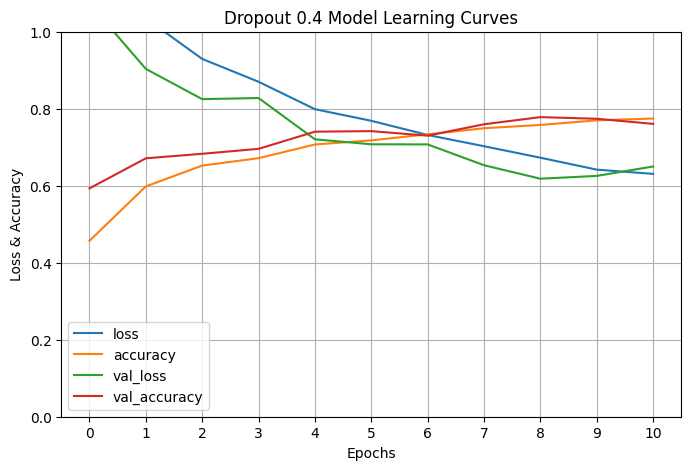


-----------------------------------------------------------------
******************** Testing dropout 0.5 ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.4088 - accuracy: 0.4129
Epoch 1: val_loss improved from inf to 1.10091, saving model to best_model_dropout_0-5.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 80s 221ms/step - loss: 1.4088 - accuracy: 0.4129 - val_loss: 1.1009 - val_accuracy: 0.5603
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.1197 - accuracy: 0.5555
Epoch 2: val_loss improved from 1.10091 to 0.96795, saving model to best_model_dropout_0-5.h5
351/351 [==============================] - 79s 227ms/step - loss: 1.1197 - accuracy: 0.5555 - val_loss: 0.9679 - val_accuracy: 0.6366
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 1.0060 - accuracy: 0.6135
Epoch 3: val_loss improved from 0.96795 to 0.90661, saving model to best_model_dropout_0-5.h5
351/351 [==============================] - 79s 226ms/step - loss: 1.0060 - accuracy: 0.6135 - val_loss: 0.9066 - val_accuracy: 0.6608
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.9278 - accuracy: 0.6531
Epoch 4: val_loss improved from 0.90661 to 0.85070, saving model to best_model_dropout_0-5.h5
351/351 [===================

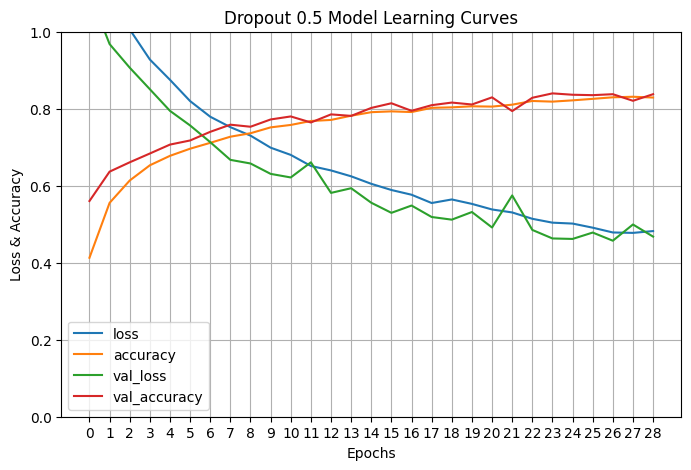


-----------------------------------------------------------------
******************** Testing dropout 0.6 ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.5604 - accuracy: 0.3386
Epoch 1: val_loss improved from inf to 1.27667, saving model to best_model_dropout_0-6.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 80s 221ms/step - loss: 1.5604 - accuracy: 0.3386 - val_loss: 1.2767 - val_accuracy: 0.5160
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.2349 - accuracy: 0.5034
Epoch 2: val_loss improved from 1.27667 to 1.03440, saving model to best_model_dropout_0-6.h5
351/351 [==============================] - 78s 222ms/step - loss: 1.2349 - accuracy: 0.5034 - val_loss: 1.0344 - val_accuracy: 0.6155
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 1.0998 - accuracy: 0.5667
Epoch 3: val_loss improved from 1.03440 to 0.93833, saving model to best_model_dropout_0-6.h5
351/351 [==============================] - 78s 221ms/step - loss: 1.0998 - accuracy: 0.5667 - val_loss: 0.9383 - val_accuracy: 0.6409
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 1.0127 - accuracy: 0.6125
Epoch 4: val_loss improved from 0.93833 to 0.89689, saving model to best_model_dropout_0-6.h5
351/351 [===================

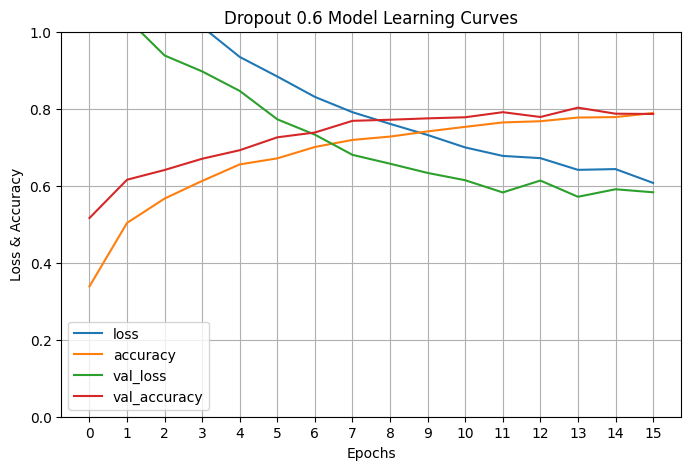

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)

# stuff for printing
dashes = '-' * 65
stars = '*' * 20

# loop through different dropout rates

dropout = [0.4, 0.5, 0.6]

for rate in dropout:
  print(f'\n{dashes}\n{stars}',f'Testing dropout {rate}',f'{stars}\n{dashes}\n')
  model = create_test_model_reg('relu', dropout=rate)

  # define model checkpoint
  drop_value = str(rate).replace('.', '-')
  model_checkpoint = ModelCheckpoint(f'best_model_dropout_{drop_value}.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)

  # train model
  model_history = model.fit(
      x=train_generator,
      validation_data=val_generator,
      epochs=50,
      batch_size=64,
      callbacks=[early_stopping, model_checkpoint],
      verbose=1
      )

  # plot learning curves
  pd.DataFrame(model_history.history).plot(figsize=(8, 5))
  plt.grid(True)
  plt.gca().set_ylim(0, 1)
  plt.title(f'Dropout {rate} Model Learning Curves')
  plt.xlabel('Epochs')
  plt.ylabel('Loss & Accuracy')
  plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
  plt.show()

  # model.summary()

To recap the performance of the best models from each of the dropout rates:

Dropout = 0:
- Training accuracy: 0.8728
- Training loss: 0.3472
- Validation accuracy: 0.8538
- Validation loss: 0.4213
- Best model: 8
- Recall that learning curves did not indicate significant overfitting by the time we reached the best model.

Dropout = 0.4:
- Training accuracy: 0.7579
- Training loss: 0.6728
- Validation accuracy: 0.7782
- Validation loss: 0.6182
- Best model: 9
- Performance is worse, but convergence seems to happen too early so a lower learning rate may improve performance here.

Dropout = 0.5:
- Training accuracy: 0.8297
- Training loss: 0.4786
- Validation accuracy: 0.8377
- Validation loss: 0.4572
- Best model: 27
- Performance is better than 0.4, but doesn't improve upon the base model.

Dropout = 0.6:
- Training accuracy: 0.7771
- Training loss: 0.6412
- Validation accuracy: 0.8028
- Validation loss: 0.5713
- Best model: 14
- Performance is similar to a rate of 0.4, and does not improve upon the base model.


-----------------------------------------------------------------
******************** Testing dropout 0.2 ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.2674 - accuracy: 0.4910
Epoch 1: val_loss improved from inf to 0.96602, saving model to best_model_dropout_0-2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 67s 182ms/step - loss: 1.2674 - accuracy: 0.4910 - val_loss: 0.9660 - val_accuracy: 0.6309
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.9659 - accuracy: 0.6337
Epoch 2: val_loss improved from 0.96602 to 0.85611, saving model to best_model_dropout_0-2.h5
351/351 [==============================] - 64s 182ms/step - loss: 0.9659 - accuracy: 0.6337 - val_loss: 0.8561 - val_accuracy: 0.6819
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.8769 - accuracy: 0.6697
Epoch 3: val_loss improved from 0.85611 to 0.72433, saving model to best_model_dropout_0-2.h5
351/351 [==============================] - 65s 184ms/step - loss: 0.8769 - accuracy: 0.6697 - val_loss: 0.7243 - val_accuracy: 0.7215
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.7965 - accuracy: 0.7029
Epoch 4: val_loss improved from 0.72433 to 0.62151, saving model to best_model_dropout_0-2.h5
351/351 [===================

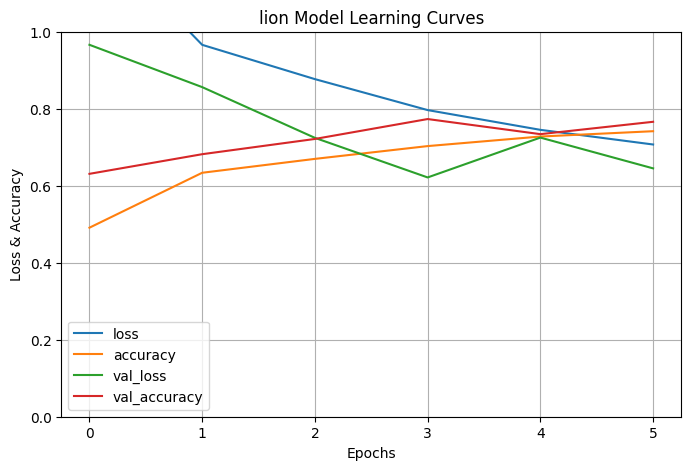


-----------------------------------------------------------------
******************** Testing dropout 0.5 ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.4434 - accuracy: 0.3928
Epoch 1: val_loss improved from inf to 1.01051, saving model to best_model_dropout_0-5.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 65s 181ms/step - loss: 1.4434 - accuracy: 0.3928 - val_loss: 1.0105 - val_accuracy: 0.5902
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.1436 - accuracy: 0.5470
Epoch 2: val_loss did not improve from 1.01051
351/351 [==============================] - 63s 179ms/step - loss: 1.1436 - accuracy: 0.5470 - val_loss: 1.0512 - val_accuracy: 0.5845
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 1.0161 - accuracy: 0.6045
Epoch 3: val_loss improved from 1.01051 to 0.90883, saving model to best_model_dropout_0-5.h5
351/351 [==============================] - 64s 183ms/step - loss: 1.0161 - accuracy: 0.6045 - val_loss: 0.9088 - val_accuracy: 0.6469
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.9424 - accuracy: 0.6434
Epoch 4: val_loss improved from 0.90883 to 0.76208, saving model to best_model_dropout_0-5.h5
351/351 [==============================] - 64s 182ms/step - loss: 0.9424 - 

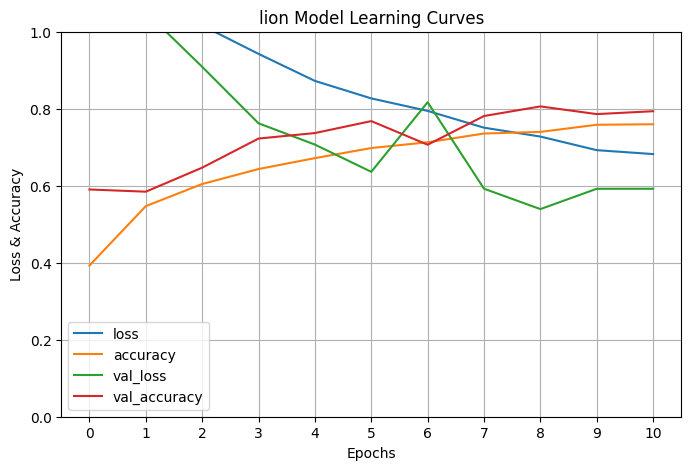


-----------------------------------------------------------------
******************** Testing dropout 0.8 ********************
-----------------------------------------------------------------

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.8099 - accuracy: 0.1822
Epoch 1: val_loss improved from inf to 1.70716, saving model to best_model_dropout_0-8.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 66s 181ms/step - loss: 1.8099 - accuracy: 0.1822 - val_loss: 1.7072 - val_accuracy: 0.3598
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 1.6702 - accuracy: 0.2710
Epoch 2: val_loss improved from 1.70716 to 1.48296, saving model to best_model_dropout_0-8.h5
351/351 [==============================] - 64s 181ms/step - loss: 1.6702 - accuracy: 0.2710 - val_loss: 1.4830 - val_accuracy: 0.3709
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 1.5178 - accuracy: 0.3492
Epoch 3: val_loss improved from 1.48296 to 1.29037, saving model to best_model_dropout_0-8.h5
351/351 [==============================] - 64s 182ms/step - loss: 1.5178 - accuracy: 0.3492 - val_loss: 1.2904 - val_accuracy: 0.4797
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 1.3958 - accuracy: 0.3985
Epoch 4: val_loss improved from 1.29037 to 1.19984, saving model to best_model_dropout_0-8.h5
351/351 [===================

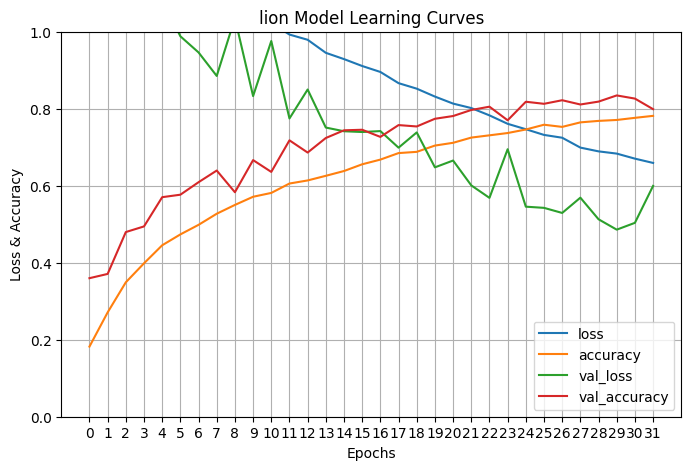

In [ ]:
### we initially tested some more extremely dropout rates, but unfortunately messed up the print/graph labels.
### based on these tests, we reran tuning on rates clustered closer to 0.5, which was the most promising

# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True, verbose=1)

# stuff for printing
dashes = '-' * 65
stars = '*' * 20

# loop through different dropout rates

dropout = [0.2, 0.5, 0.8]

for rate in dropout:
  print(f'\n{dashes}\n{stars}',f'Testing dropout {rate}',f'{stars}\n{dashes}\n')
  model = create_test_model_reg('relu', dropout=rate)

  # define model checkpoint
  drop_value = str(rate).replace('.', '-')
  model_checkpoint = ModelCheckpoint(f'best_model_dropout_{drop_value}.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)

  # train model
  model_history = model.fit(
      x=train_generator,
      validation_data=val_generator,
      epochs=50,
      callbacks=[early_stopping, model_checkpoint],
      verbose=1
      )

  # plot learning curves
  pd.DataFrame(model_history.history).plot(figsize=(8, 5))
  plt.grid(True)
  plt.gca().set_ylim(0, 1)
  plt.title(f'Dropout {rate} Model Learning Curves')
  plt.xlabel('Epochs')
  plt.ylabel('Loss & Accuracy')
  plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
  plt.show()

  # model.summary()

### Testing Initializations

We'll test:
- Glorot Uniform
- Glorot Normal
- He Uniform
- He Normal

In [ ]:
# new function for testing initializations
def create_test_model_init(activation, init):

  # this is the same simple model we previously built
  model = Sequential([
      Conv2D(32, (3, 3), activation=activation, kernel_initializer=init, input_shape=(150, 150, 3)),
      MaxPool2D((2, 2)),
      Conv2D(64, (3, 3), activation=activation, kernel_initializer=init),
      MaxPool2D((2, 2)),
      Conv2D(128, (3, 3), activation=activation, kernel_initializer=init),
      MaxPool2D((2, 2)),
      Flatten(input_shape=(150,150, 3)),
      Dense(1024, activation=activation, kernel_initializer=init),
      Dense(512, activation=activation, kernel_initializer=init),
      Dense(256, activation=activation, kernel_initializer=init), # updated because we weren't passing the activation function to the function - JW
      Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
  ])

  # compile the model
  model.compile(
      optimizer=Adam(1e-4),
      loss='categorical_crossentropy',
      metrics=['accuracy']
  )

  return model


-----------------------------------------------------------------
******************** Testing glorot_normal ********************
-----------------------------------------------------------------

Epoch 1/30
351/351 [==============================] - ETA: 0s - loss: 361984.8125 - accuracy: 0.1666
Epoch 1: val_loss improved from inf to 1.79410, saving model to best_model_glorot_normal.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 106s 296ms/step - loss: 361984.8125 - accuracy: 0.1666 - val_loss: 1.7941 - val_accuracy: 0.1714
Epoch 2/30
351/351 [==============================] - ETA: 0s - loss: 1.7974 - accuracy: 0.1695
Epoch 2: val_loss did not improve from 1.79410
351/351 [==============================] - 104s 295ms/step - loss: 1.7974 - accuracy: 0.1695 - val_loss: 1.8083 - val_accuracy: 0.1714
Epoch 3/30
351/351 [==============================] - ETA: 0s - loss: 1.7971 - accuracy: 0.1682
Epoch 3: val_loss did not improve from 1.79410
351/351 [==============================] - 102s 291ms/step - loss: 1.7971 - accuracy: 0.1682 - val_loss: 1.7970 - val_accuracy: 0.1714
Epoch 4/30
351/351 [==============================] - ETA: 0s - loss: 1.8016 - accuracy: 0.1647Restoring model weights from the end of the best epoch: 1.

Epoch 4: val_loss did not improve from 1.79410
351/351 [==============================] - 103s 293ms/step - loss: 1.8016 - accuracy: 0.1647 - val_los

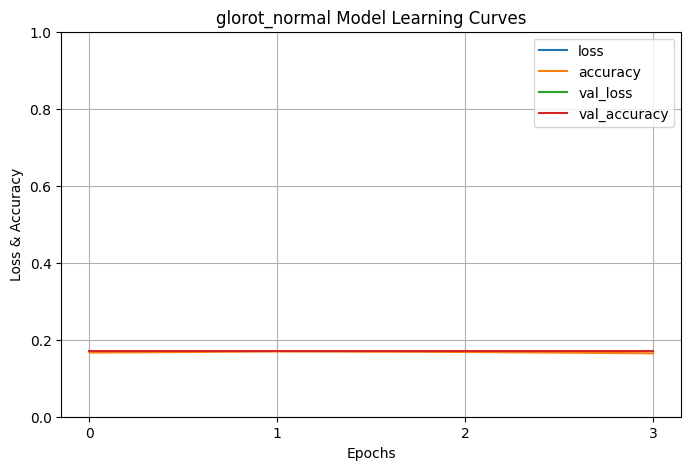


-----------------------------------------------------------------
******************** Testing glorot_uniform ********************
-----------------------------------------------------------------

Epoch 1/30
351/351 [==============================] - ETA: 0s - loss: 276979.9062 - accuracy: 0.1708
Epoch 1: val_loss improved from inf to 1.79818, saving model to best_model_glorot_uniform.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 104s 291ms/step - loss: 276979.9062 - accuracy: 0.1708 - val_loss: 1.7982 - val_accuracy: 0.1714
Epoch 2/30
351/351 [==============================] - ETA: 0s - loss: 1.7977 - accuracy: 0.1684
Epoch 2: val_loss improved from 1.79818 to 1.79406, saving model to best_model_glorot_uniform.h5
351/351 [==============================] - 103s 295ms/step - loss: 1.7977 - accuracy: 0.1684 - val_loss: 1.7941 - val_accuracy: 0.1781
Epoch 3/30
351/351 [==============================] - ETA: 0s - loss: 1.7983 - accuracy: 0.1690
Epoch 3: val_loss did not improve from 1.79406
351/351 [==============================] - 102s 292ms/step - loss: 1.7983 - accuracy: 0.1690 - val_loss: 1.8015 - val_accuracy: 0.1651
Epoch 4/30
351/351 [==============================] - ETA: 0s - loss: 1.8008 - accuracy: 0.1683
Epoch 4: val_loss did not improve from 1.79406
351/351 [==============================] - 102s 292ms/step - loss: 1.8008 - accuracy: 0.1683 - val_loss: 1.8023

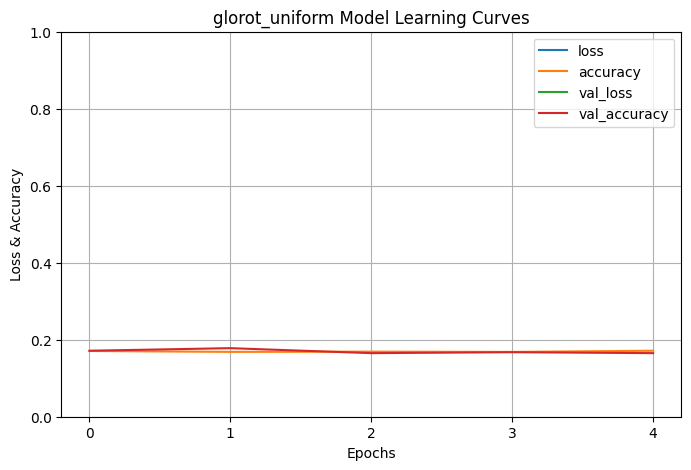


-----------------------------------------------------------------
******************** Testing he_normal ********************
-----------------------------------------------------------------

Epoch 1/30
351/351 [==============================] - ETA: 0s - loss: 323843.1562 - accuracy: 0.1676
Epoch 1: val_loss improved from inf to 1.79856, saving model to best_model_he_normal.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 106s 296ms/step - loss: 323843.1562 - accuracy: 0.1676 - val_loss: 1.7986 - val_accuracy: 0.1781
Epoch 2/30
351/351 [==============================] - ETA: 0s - loss: 1.8254 - accuracy: 0.1684
Epoch 2: val_loss improved from 1.79856 to 1.79669, saving model to best_model_he_normal.h5
351/351 [==============================] - 103s 295ms/step - loss: 1.8254 - accuracy: 0.1684 - val_loss: 1.7967 - val_accuracy: 0.1781
Epoch 3/30
351/351 [==============================] - ETA: 0s - loss: 1.9442 - accuracy: 0.1719
Epoch 3: val_loss did not improve from 1.79669
351/351 [==============================] - 102s 291ms/step - loss: 1.9442 - accuracy: 0.1719 - val_loss: 1.8025 - val_accuracy: 0.1624
Epoch 4/30
351/351 [==============================] - ETA: 0s - loss: 1.8021 - accuracy: 0.1677
Epoch 4: val_loss did not improve from 1.79669
351/351 [==============================] - 104s 296ms/step - loss: 1.8021 - accuracy: 0.1677 - val_loss: 1.8027 - va

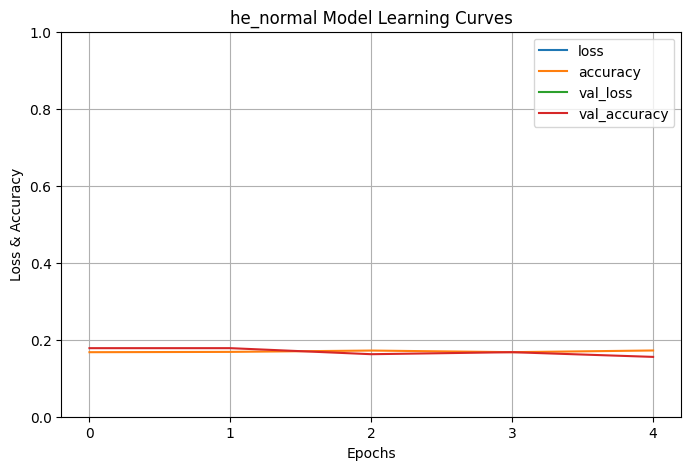


-----------------------------------------------------------------
******************** Testing he_uniform ********************
-----------------------------------------------------------------

Epoch 1/30
351/351 [==============================] - ETA: 0s - loss: 563099.6250 - accuracy: 0.1714
Epoch 1: val_loss improved from inf to 1.79511, saving model to best_model_he_uniform.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 108s 303ms/step - loss: 563099.6250 - accuracy: 0.1714 - val_loss: 1.7951 - val_accuracy: 0.1714
Epoch 2/30
351/351 [==============================] - ETA: 0s - loss: 1.7970 - accuracy: 0.1665
Epoch 2: val_loss did not improve from 1.79511
351/351 [==============================] - 103s 295ms/step - loss: 1.7970 - accuracy: 0.1665 - val_loss: 1.8060 - val_accuracy: 0.1651
Epoch 3/30
351/351 [==============================] - ETA: 0s - loss: 1.7985 - accuracy: 0.1744
Epoch 3: val_loss improved from 1.79511 to 1.79236, saving model to best_model_he_uniform.h5
351/351 [==============================] - 105s 300ms/step - loss: 1.7985 - accuracy: 0.1744 - val_loss: 1.7924 - val_accuracy: 0.1781
Epoch 4/30
351/351 [==============================] - ETA: 0s - loss: 1.7984 - accuracy: 0.1689
Epoch 4: val_loss did not improve from 1.79236
351/351 [==============================] - 104s 297ms/step - loss: 1.7984 - accuracy: 0.1689 - val_loss: 1.7966 - v

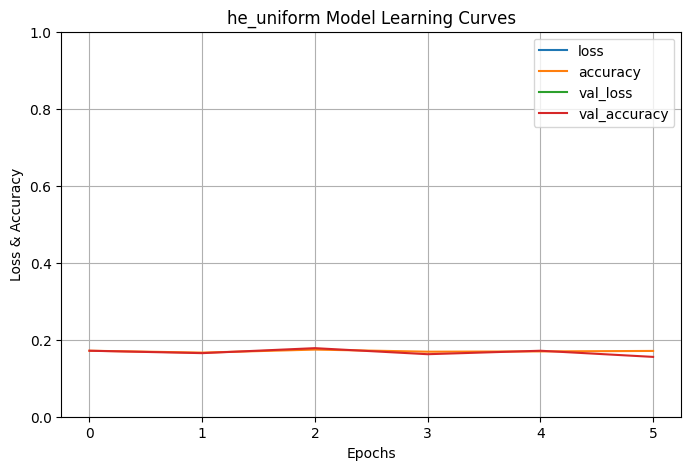

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)

# stuff for printing
dashes = '-' * 65
stars = '*' * 20

# loop through different initializers
initializers = ['glorot_normal', 'glorot_uniform', 'he_normal', 'he_uniform']


for init in initializers:
  print(f'\n{dashes}\n{stars}',f'Testing {init}',f'{stars}\n{dashes}\n')
  model = create_test_model_init('relu', init)

  # define model checkpoint
  model_checkpoint = ModelCheckpoint(f'best_model_{init}.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)


  model_history = model.fit(
      x=train_generator,
      epochs=30,
      batch_size=64,
      validation_data=val_generator,
      callbacks=[early_stopping, model_checkpoint],
      verbose=1)

  pd.DataFrame(model_history.history).plot(figsize=(8, 5))
  plt.grid(True)
  plt.gca().set_ylim(0, 1)
  plt.title(f'{init} Model Learning Curves')
  plt.xlabel('Epochs')
  plt.ylabel('Loss & Accuracy')
  plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
  plt.show()

To recap the performance of the best models from each initializer:

None:
- Training accuracy: 0.8728
- Training loss: 0.3472
- Validation accuracy: 0.8538
- Validation loss: 0.4213
- Best Model: 8
- Recall that learning curves did not indicate significant overfitting by the time we reached the best model.

Glorot Normal:
- Training accuracy: 0.1666
- Training loss: 361984.8125
- Validation accuracy: 0.1714
- Validation loss: 1.7941
- Best Model: 1

Glorot Uniform:
- Training accuracy: 0.1684
- Training loss: 1.7977
- Validation accuracy: 1.7941
- Validation loss: 1.7941
- Best Model: 2

He Normal:
- Training accuracy: 0.1684
- Training loss: 1.8254
- Validation accuracy: 0.1781
- Validation loss: 1.7967
- Best Model: 2

He Uniform:
- Training accuracy: 0.1744
- Training loss: 1.7985
- Validation accuracy: 0.1781
- Validation loss: 1.7924
- Best Model: 3

All of them appeared to be severely overfitting. It's hard to say which one would be better, but further tuning would likely require a significantly lower learning rate.

# Test Model With More Layers

In [ ]:
# this is the same simple model we previously built
activaton = 'relu'

model = Sequential([
    Conv2D(32, (3, 3), input_shape=(150, 150, 3)),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    MaxPool2D((2, 2)),
    Conv2D(64, (3, 3)),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    MaxPool2D((2, 2)),
    Conv2D(128, (3, 3)),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    MaxPool2D((2, 2)),
    Flatten(input_shape=(150,150, 3)),
    Dense(1024),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    Dense(512),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    Dense(256),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    Dense(128),
    BatchNormalization(epsilon=1e-5),
    Activation(activaton),
    Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
])

# compile the model
model.compile(
    optimizer=Adam(1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True, verbose=1)

# define model checkpoint
model_checkpoint = ModelCheckpoint(f'best_deeper_model.keras', monitor='val_loss', mode='min', save_best_only=True, verbose=1)


model_history = model.fit(
    x=train_generator,
    epochs=100,
    batch_size=128,
    validation_data=val_generator,
    callbacks=[early_stopping, model_checkpoint],
    verbose=1)

Epoch 1/100
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step - accuracy: 0.4929 - loss: 1.3331
Epoch 1: val_loss improved from inf to 2.26520, saving model to best_deeper_model.keras
116/116 ━━━━━━━━━━━━━━━━━━━━ 81s 673ms/step - accuracy: 0.4935 - loss: 1.3318 - val_accuracy: 0.1718 - val_loss: 2.2652
Epoch 2/100
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step - accuracy: 0.6308 - loss: 0.9830
Epoch 2: val_loss did not improve from 2.26520
116/116 ━━━━━━━━━━━━━━━━━━━━ 77s 661ms/step - accuracy: 0.6310 - loss: 0.9827 - val_accuracy: 0.1747 - val_loss: 2.6102
Epoch 3/100
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step - accuracy: 0.6644 - loss: 0.8708
Epoch 3: val_loss improved from 2.26520 to 2.03914, saving model to best_deeper_model.keras
116/116 ━━━━━━━━━━━━━━━━━━━━ 82s 702ms/step - accuracy: 0.6644 - loss: 0.8708 - val_accuracy: 0.2688 - val_loss: 2.0391
Epoch 4/100
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step - accuracy: 0.7157 - loss: 0.7864
Epoch 4: val_loss improved from 2.03914 to 1.51805, savin

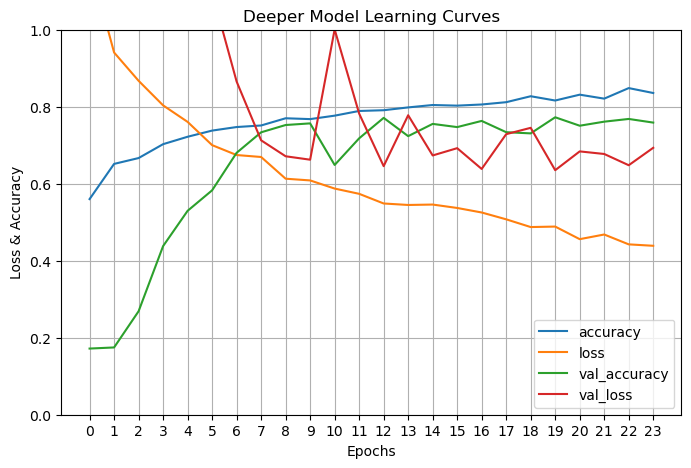

In [ ]:
pd.DataFrame(model_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.title(f'Deeper Model Learning Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss & Accuracy')
plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
plt.show()

In [ ]:
# make predictions
simple_preds = model.predict(X_test_norm)
pred_labels = np.argmax(simple_preds, axis=1)
true_labels = y_test

94/94 ━━━━━━━━━━━━━━━━━━━━ 5s 55ms/step


In [ ]:
# print performance metrics
accuracy = accuracy_score(true_labels, pred_labels)
precision = precision_score(true_labels, pred_labels, average="macro")
recall = recall_score(true_labels, pred_labels, average="macro")
f1 = f1_score(true_labels, pred_labels, average="macro")

print(f'accuracy score: {accuracy}')
print(f'precision score: {precision}')
print(f'recall score: {recall}')
print(f'f1 score: {f1}')

accuracy score: 0.8023333333333333
precision score: 0.8084816899639624
recall score: 0.8063651516591878
f1 score: 0.8037783341866596


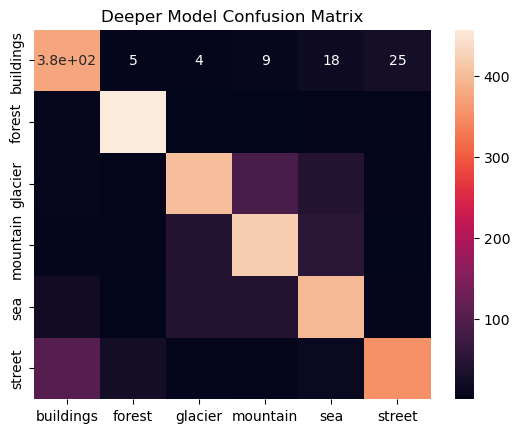

In [ ]:
CM = confusion_matrix(true_labels, pred_labels)
ax = plt.axes()
sns.heatmap(CM, annot=True,
           annot_kws={"size": 10},
           xticklabels=class_names,
           yticklabels=class_names, ax = ax)
ax.set_title('Deeper Model Confusion Matrix')
plt.show()

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True, verbose=1)

# define model checkpoint
model_checkpoint = ModelCheckpoint(f'best_deeper_model.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)


model_history = model.fit(
    x=train_generator,
    epochs=50,
    batch_size=128,
    validation_data=val_generator,
    callbacks=[early_stopping, model_checkpoint],
    verbose=1)

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.0118 - accuracy: 0.6185
Epoch 1: val_loss improved from inf to 2.47524, saving model to best_deeper_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


351/351 [==============================] - 109s 296ms/step - loss: 1.0118 - accuracy: 0.6185 - val_loss: 2.4752 - val_accuracy: 0.1957
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.7800 - accuracy: 0.7083
Epoch 2: val_loss improved from 2.47524 to 0.94493, saving model to best_deeper_model.h5
351/351 [==============================] - 103s 293ms/step - loss: 0.7800 - accuracy: 0.7083 - val_loss: 0.9449 - val_accuracy: 0.6486
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.7028 - accuracy: 0.7385
Epoch 3: val_loss improved from 0.94493 to 0.64269, saving model to best_deeper_model.h5
351/351 [==============================] - 104s 296ms/step - loss: 0.7028 - accuracy: 0.7385 - val_loss: 0.6427 - val_accuracy: 0.7591
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.6466 - accuracy: 0.7600
Epoch 4: val_loss did not improve from 0.64269
351/351 [==============================] - 101s 289ms/step - loss: 0.6466 - accura

# Test Model with Sobel Edge Detection

We are adding Sobel edge detection to attempt to improve the differentiation between seas, glaciers, and mountains

In [ ]:
# first, load validation data
X_test, y_test = load_data(val_dir)

Loading /content/intel-image-classification/seg_val/


100%|██████████| 476/476 [00:00<00:00, 2002.64it/s]


In [ ]:
# create the preprocessing function
def preprocess_image(image):
  # Convert image to grayscale
  gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
  # Apply Sobel edge detection
  sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
  sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
  # Combine x and y Sobel edges
  edges = np.sqrt(sobel_x**2 + sobel_y**2)
  # Rescale edges to [0, 255] range
  edges = (edges / np.max(edges)) * 255
  # Convert edges to uint8
  edges = edges.astype(np.uint8)
  # Expand dimensions to match input shape
  edges = np.expand_dims(edges, axis=-1)
  # Concatenate original image with edges
  processed_image = np.concatenate([image, edges], axis=-1)
  return processed_image

In [ ]:
# apply the preprocessing on the train and test images - note, this changes the input shape to (150,150,4)
X_train.shape

X_train_preprocessed = []
for image in X_train:
  preprocessed_image = preprocess_image(image)
  X_train_preprocessed.append(preprocessed_image)

X_train_preprocessed = np.array(X_train_preprocessed)

X_test_preprocessed = []
for image in X_test:
  preprocessed_image = preprocess_image(image)
  X_test_preprocessed.append(preprocessed_image)

X_test_preprocessed = np.array(X_test_preprocessed)

In [ ]:
# convert y to categorical, since the ImageDataGen .flow method doesn't do so automatically
y_train_categorical = to_categorical(y_train)
y_test_categorical = to_categorical(y_test)

In [ ]:
# Load training data using flow and apply resizing and augmentation
train_generator_prepro = train_datagen.flow(
    X_train_preprocessed,
    y_train_categorical,               # Path to training data directory
    batch_size=BATCH_SIZE,              # Batch size           # Classification mode
    shuffle=True                        # Shuffle training data
)

# Load validation data using flow and apply resizing and augmentation
val_generator_prepro = train_datagen.flow(
    X_test_preprocessed,
    y_test_categorical,             # Resize images to IMAGE_SIZE
    batch_size=BATCH_SIZE,              # Batch size           # Classification mode
    shuffle=True                        # Shuffle validation data
)

# Load test data without augmentation
test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
def create_test_model_prepro(activation, dropout=0, init=None):

  early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True, verbose=1)
  model_checkpoint = ModelCheckpoint(f'best_prepro_model.h5', monitor='val_loss', mode='min', save_best_only=True, verbose=1)

  # this is the same simple model we previously built
  model = Sequential([
      Conv2D(32, (3, 3), activation=activation, input_shape=(150, 150, 4)),
      MaxPool2D((2, 2)),
      Conv2D(64, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Conv2D(128, (3, 3), activation=activation),
      MaxPool2D((2, 2)),
      Flatten(),
      Dense(1024, activation=activation, kernel_initializer=init),
      Dropout(rate = dropout),
      Dense(512, activation=activation),
      Dropout(rate = dropout),
      Dense(256, activation=activation), # updated because we weren't passing the activation function to the function - JW
      Dropout(rate = dropout),
      Dense(6, activation='softmax') # output layer with 6 neurons, for 6 target classes
  ])

  model.compile(
      optimizer=Adam(1e-4),
      loss='categorical_crossentropy',
      metrics=['accuracy']
  )

  model_history = model.fit(
      x=train_generator_prepro, # update w/ transformations,
      epochs=150,
      batch_size=128,  # speeds up training and achieves same learning result in less epochs - ABR
      validation_data=val_generator_prepro,
      callbacks=[early_stopping, model_checkpoint],
      verbose=1)

  pd.DataFrame(model_history.history).plot(figsize=(8, 5))
  plt.grid(True)
  plt.gca().set_ylim(0, 1)
  plt.title(f'Sobel Edge Detection Model Learning Curves')
  plt.xlabel('Epochs')
  plt.ylabel('Loss & Accuracy')
  plt.xticks(range(len(model_history.history['loss']))) # set xticks to step by 1
  plt.show()

Epoch 1/150
439/439 [==============================] - ETA: 0s - loss: 1.3920 - accuracy: 0.4253
Epoch 1: val_loss improved from inf to 1.01839, saving model to best_prepro_model.h5
439/439 [==============================] - 111s 238ms/step - loss: 1.3920 - accuracy: 0.4253 - val_loss: 1.0184 - val_accuracy: 0.5959
Epoch 2/150
439/439 [==============================] - ETA: 0s - loss: 1.0552 - accuracy: 0.5828
Epoch 2: val_loss improved from 1.01839 to 0.87148, saving model to best_prepro_model.h5
439/439 [==============================] - 105s 239ms/step - loss: 1.0552 - accuracy: 0.5828 - val_loss: 0.8715 - val_accuracy: 0.6712
Epoch 3/150
439/439 [==============================] - ETA: 0s - loss: 0.9342 - accuracy: 0.6429
Epoch 3: val_loss improved from 0.87148 to 0.79811, saving model to best_prepro_model.h5
439/439 [==============================] - 105s 239ms/step - loss: 0.9342 - accuracy: 0.6429 - val_loss: 0.7981 - val_accuracy: 0.7079
Epoch 4/150
439/439 [====================

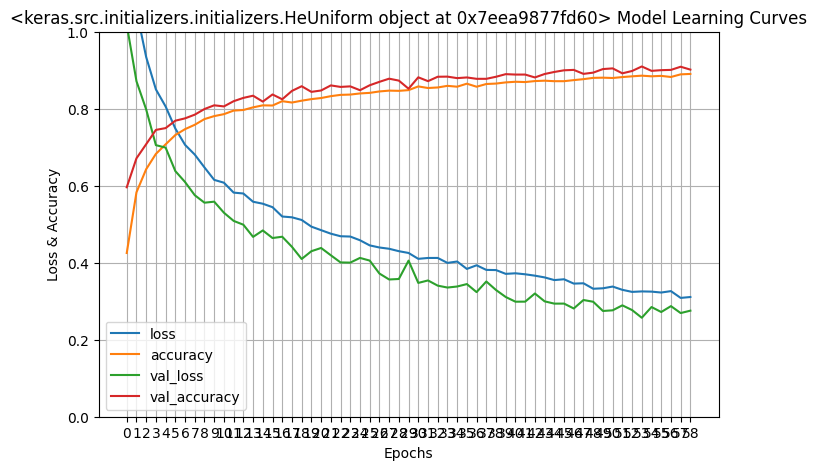

In [ ]:
create_test_model_prepro('relu', dropout=0.5, init=tf.keras.initializers.HeUniform())

### Evaluate Predictions of the Sobel Model

In [ ]:
# display the summary of the best model
sobel_model = tf.keras.models.load_model('best_prepro_model.h5')
sobel_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      1184      
                                                                 
 max_pooling2d (MaxPooling2  (None, 74, 74, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 36, 36, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 17, 17, 128)       0

In [ ]:
# make predictions with Sobel model
sobel_preds = sobel_model.predict(X_test_preprocessed)
pred_labels = np.argmax(sobel_preds, axis=1)
true_labels = y_test

88/88 [==============================] - 0s 3ms/step


In [ ]:
# print performance metrics
accuracy = accuracy_score(true_labels, pred_labels)
precision = precision_score(true_labels, pred_labels, average="macro")
recall = recall_score(true_labels, pred_labels, average="macro")
f1 = f1_score(true_labels, pred_labels, average="macro")

print(f'accuracy score: {accuracy}')
print(f'precision score: {precision}')
print(f'recall score: {recall}')
print(f'f1 score: {f1}')

accuracy score: 0.56811697574893
precision score: 0.7655264739069447
recall score: 0.574553213497834
f1 score: 0.5452080388513197


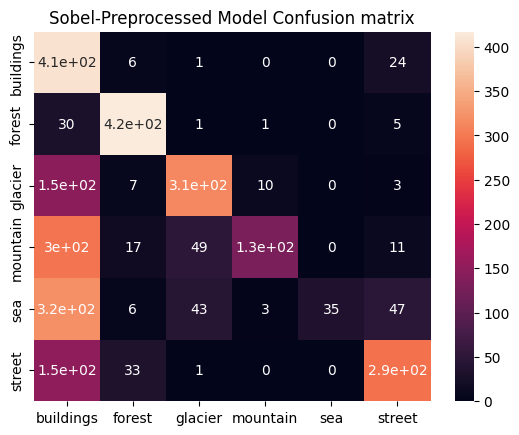

In [ ]:
CM = confusion_matrix(true_labels, pred_labels)
ax = plt.axes()
sns.heatmap(CM, annot=True,
           annot_kws={"size": 10},
           xticklabels=class_names,
           yticklabels=class_names, ax = ax)
ax.set_title('Sobel-Preprocessed Model Confusion matrix')
plt.show()

Epoch 1/150
439/439 [==============================] - ETA: 0s - loss: 1.4052 - accuracy: 0.4261
Epoch 1: val_loss improved from inf to 1.09215, saving model to best_prepro_model.keras
439/439 [==============================] - 127s 276ms/step - loss: 1.4052 - accuracy: 0.4261 - val_loss: 1.0922 - val_accuracy: 0.5710
Epoch 2/150
439/439 [==============================] - ETA: 0s - loss: 1.0863 - accuracy: 0.5777
Epoch 2: val_loss improved from 1.09215 to 0.94108, saving model to best_prepro_model.keras
439/439 [==============================] - 122s 277ms/step - loss: 1.0863 - accuracy: 0.5777 - val_loss: 0.9411 - val_accuracy: 0.6364
Epoch 3/150
439/439 [==============================] - ETA: 0s - loss: 0.9581 - accuracy: 0.6354
Epoch 3: val_loss improved from 0.94108 to 0.83447, saving model to best_prepro_model.keras
439/439 [==============================] - 120s 274ms/step - loss: 0.9581 - accuracy: 0.6354 - val_loss: 0.8345 - val_accuracy: 0.6851
Epoch 4/150
439/439 [===========

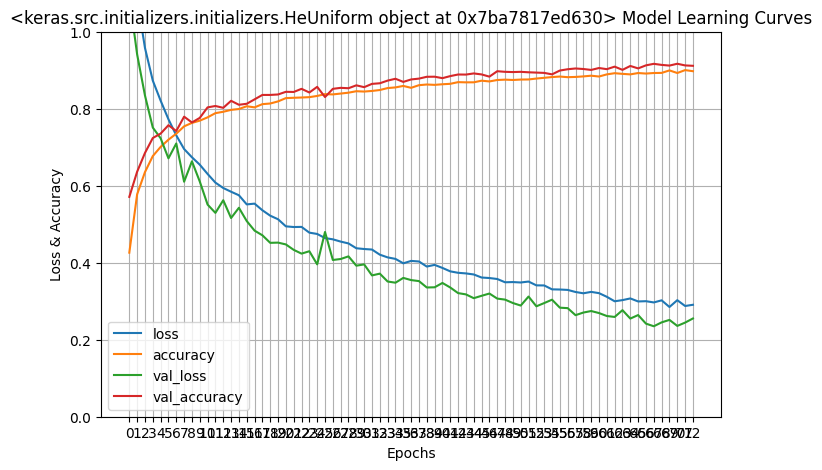

In [ ]:
# note: these are the results of the first run of the sobel model
# unfortunately, the runtime crashed before we could evalute its predictions
create_test_model_prepro('relu', dropout=0.5, init=tf.keras.initializers.HeUniform())

***
# ResNet50

In [ ]:
# quick check of ResNet50 layers
from keras.applications.resnet50 import ResNet50
from keras.layers import Input

image_input=Input(shape=(150, 150, 3))
model = ResNet50(input_tensor=image_input,weights='imagenet',include_top=False)
model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 518, 518, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 256, 256, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 256, 256, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

TensorShape([None, 16, 16, 1])

In [ ]:
# Load ResNet50 model without the top layers and specify the input shape
resnet_base = ResNet50(weights='imagenet', include_top=False, input_shape=(150, 150, 3))

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


## Plot ResNet50 Base Model Predictions with PCA Visualization

In [ ]:
# predict X_train_norm using only base layer of ResNet, so this is unseen data
train_features = resnet_base.predict(X_train_norm)

# reshape and flatten feature map in preparation for PCA
n_train, x, y, z = train_features.shape
numFeatures = x*y*z

train_reshaped = train_features.reshape((n_train, numFeatures)) # flatten

# dimensionality reduction using PCA
pca=PCA(n_components=2)

pca.fit(train_reshaped)
X = pca.transform(train_reshaped) # tranform into 2D
print(X.shape)

C1 = X[:,0]
C2 = X[:,1]

439/439 [==============================] - 6s 11ms/step
(14034, 2)


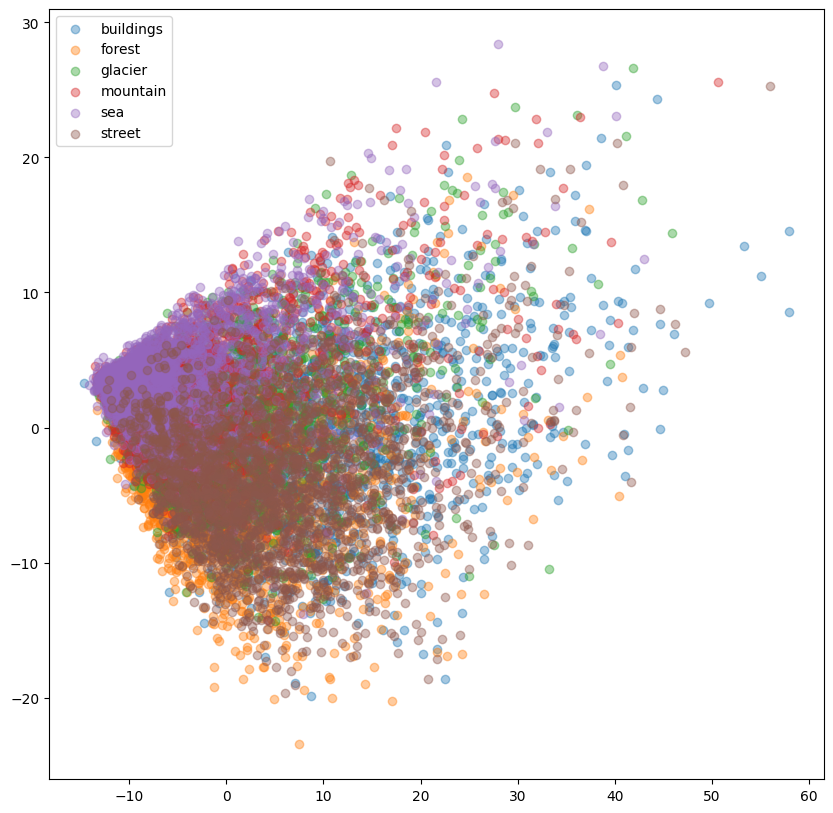

In [ ]:
# plot the relationships
plt.subplots(figsize=(10,10))

for i, class_name in enumerate(class_names):
  plt.scatter(C1[y_train == i], C2[y_train == i], alpha=0.4, label=class_name)
plt.legend()
plt.title(f'PCA Visualization of Base ResNet50 Predictions')
plt.xlabel('X')
plt.ylabel('y')
plt.show()

This doesn't tell us much

## Transfer Learning Model Using ResNet50

In [ ]:
# create a simple one layer model on top of resnet_base
resnet_model = tf.keras.Sequential([resnet_base,
                                    layers.Flatten(),
                                    layers.Dense(64, activation='relu'),
                                    layers.Dense(6, activation='softmax')])

# freeze the base model
resnet_base.trainable = False

# compile the model
resnet_model.compile(
    optimizer=Adam(1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
# define early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True, verbose=1)

# define model checkpoint
model_checkpoint = ModelCheckpoint(f'best_resnet_model.keras', monitor='val_loss', mode='min', save_best_only=True, verbose=1)

resnet_model_history = resnet_model.fit(
    x=train_generator,
    validation_data=val_generator,
    epochs=50,
    batch_size=265,
    callbacks=[early_stopping, model_checkpoint],
    verbose=1
    )

Epoch 1/50


/opt/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


351/351 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step - accuracy: 0.3142 - loss: 1.6369
Epoch 1: val_loss improved from inf to 1.32082, saving model to best_resnet_model.keras
351/351 ━━━━━━━━━━━━━━━━━━━━ 135s 378ms/step - accuracy: 0.3144 - loss: 1.6366 - val_accuracy: 0.4879 - val_loss: 1.3208
Epoch 2/50
351/351 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step - accuracy: 0.4736 - loss: 1.3124
Epoch 2: val_loss improved from 1.32082 to 1.23593, saving model to best_resnet_model.keras
351/351 ━━━━━━━━━━━━━━━━━━━━ 132s 373ms/step - accuracy: 0.4737 - loss: 1.3123 - val_accuracy: 0.5004 - val_loss: 1.2359
Epoch 3/50
351/351 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step - accuracy: 0.5047 - loss: 1.2369
Epoch 3: val_loss improved from 1.23593 to 1.18075, saving model to best_resnet_model.keras
351/351 ━━━━━━━━━━━━━━━━━━━━ 131s 372ms/step - accuracy: 0.5047 - loss: 1.2368 - val_accuracy: 0.5232 - val_loss: 1.1808
Epoch 4/50
351/351 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step - accuracy: 0.5306 - loss: 1.1763
Epoch 4: val_loss improv

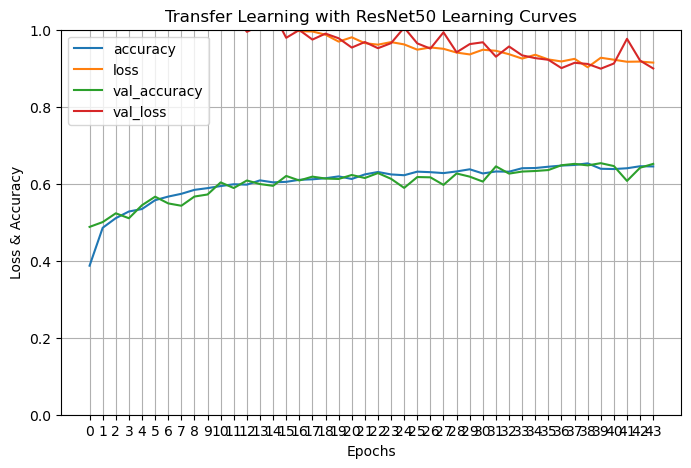

In [ ]:
pd.DataFrame(resnet_model_history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.title(f'Transfer Learning with ResNet50 Learning Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss & Accuracy')
plt.xticks(range(len(resnet_model_history.history['loss']))) # set xticks to step by 1
plt.show()

## Evaluate Predictions of the ResNet50-Adapted Model

In [ ]:
# use resnet model to make predictions on the test set
resnet_preds = resnet_model.predict(X_test_norm)

resnet_preds

94/94 ━━━━━━━━━━━━━━━━━━━━ 29s 300ms/step


array([[3.1351428e-03, 9.7430938e-01, 2.1893503e-04, 2.2287606e-05,
        3.6950345e-04, 2.1944733e-02],
       [3.4649562e-02, 5.8469009e-01, 1.5987895e-02, 5.2056406e-03,
        3.0627898e-03, 3.5640392e-01],
       [3.2590315e-02, 9.2515713e-01, 6.8473903e-04, 3.1575681e-05,
        6.4722270e-05, 4.1471474e-02],
       ...,
       [2.8601993e-02, 3.8993716e-05, 5.5486721e-01, 8.9886434e-02,
        3.1201386e-01, 1.4591475e-02],
       [1.3370318e-02, 3.9754108e-02, 4.8448199e-01, 9.6602224e-02,
        3.6414415e-01, 1.6471907e-03],
       [5.2834883e-02, 2.2555711e-03, 1.4040278e-01, 1.2656568e-01,
        6.7218995e-01, 5.7511437e-03]], dtype=float32)

In [ ]:
# print performance metrics
accuracy_scaled = accuracy_score(y_test, resnet_preds)
# precision_scaled = precision_score(y_test, y_pred_scaled, average="macro")
# recall_scaled = recall_score(y_test, y_pred_scaled, average="macro")
f1_scaled = f1_score(y_test, resnet_preds, average="macro")
# roc_auc_scaled = roc_auc_score(y_test, y_pred_probas_scaled, multi_class="ovr")

print(f'accuracy score: {accuracy_scaled}')
# print(f'precision score: {precision_scaled}')
# print(f'recall score: {recall_scaled}')
print(f'f1 score: {f1_scaled}')
# print(f'ROC AUC score: {roc_auc_scaled}')

## Plot Predictions with t-SNE Visualization

In [ ]:
display(X_test_norm.shape)

# flatten image vector
X_test_flat = X_test_norm.reshape(X_test_norm.shape[0], -1) # reshape to (n_samples, n_features)
X_test_flat.shape

(3000, 150, 150, 3)

(3000, 67500)

In [ ]:
# prepare data by scaling
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X_test_flat)
X_scaled

array([[0.30588235, 0.52156863, 0.78431373, ..., 0.59215686, 0.58823529,
        0.58039216],
       [0.51764706, 0.47843137, 0.58431373, ..., 0.32156863, 0.23921569,
        0.17254902],
       [0.56470588, 0.59215686, 0.61568627, ..., 0.65882353, 0.6627451 ,
        0.67843137],
       ...,
       [1.        , 1.        , 1.        , ..., 0.71764706, 0.6745098 ,
        0.59607843],
       [0.68627451, 0.91372549, 0.99215686, ..., 0.00392157, 0.        ,
        0.05490196],
       [0.49411765, 0.70980392, 0.93333333, ..., 0.78039216, 0.78823529,
        0.84705882]])

In [ ]:
# dimensionality reduction using t-SNE
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_scaled)

# map integer values in y to class names
class_names = {v: k for k, v in class_names_labels.items()}
y_test_names = [class_names[label] for label in y_test]

In [ ]:
# plot the data
fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=y_test_names)
fig.update_layout(
    title="t-SNE visualization of ResNet50-Based Model Predictions",
    xaxis_title="X",
    yaxis_title="y",
    height=1000,
    margin=dict(r=100)
)
fig.show()

# VGG16

In [ ]:
# see how VGG performs
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input

vgg_base = VGG16(weights='imagenet', include_top=False)

vgg_model = tf.keras.Sequential([vgg_base,
                                    layers.Flatten(),
                                    layers.Dense(64, activation='relu'),
                                    layers.Dense(6, activation='softmax')])

# Freeze the base model
vgg_base.trainable = False

# Compile the model
vgg_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# train
vgg_model.fit(
    X_train,
    y_train,
    epochs=20,
    batch_size=64,
    validation_split=0.2,
    callbacks=[early_stopping, model_checkpoint],
    verbose=1
)


58889256/58889256 [==============================] - 3s 0us/step


### PCA

In [ ]:
train_features = vgg_base.predict(X_train_norm)

n_train, x, y, z = train_features.shape
numFeatures = x*y*z

train_reshaped = train_features.reshape((n_train, numFeatures)) # flatten

pca.fit(train_reshaped)
X = pca.transform(train_reshaped) # tranform into 2D
print(X.shape)

C1 = X[:,0]
C2 = X[:,1]

439/439 [==============================] - 5s 10ms/step
(14034, 2)


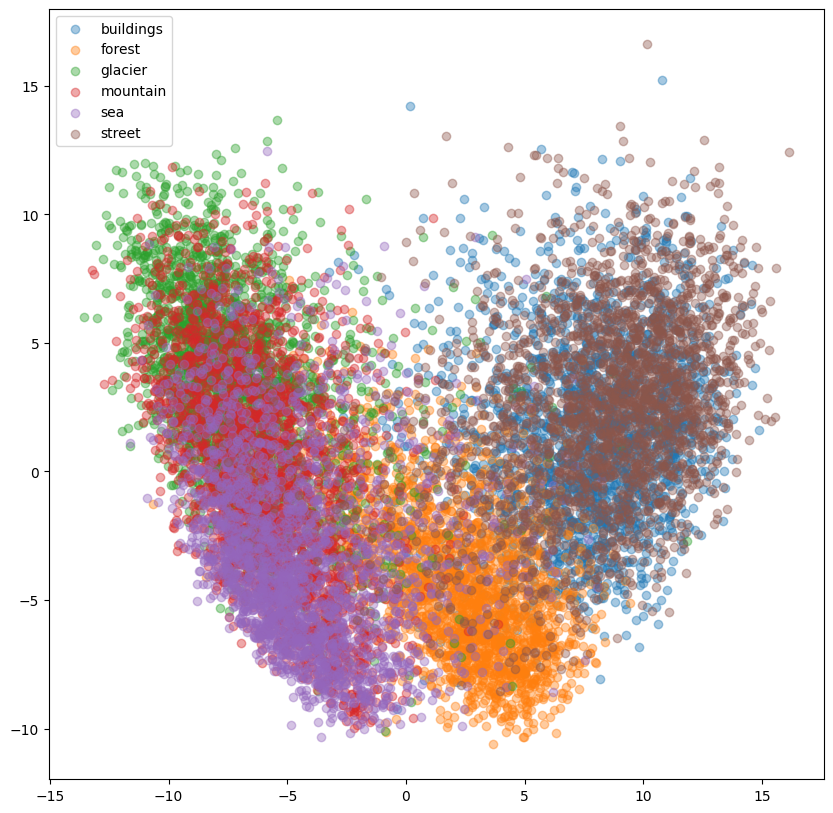

In [ ]:
# plot the relationships

plt.subplots(figsize=(10,10))

for i, class_name in enumerate(class_names):
  plt.scatter(C1[y_train == i], C2[y_train == i], alpha=0.4, label=class_name)
plt.legend()
plt.show()

Interesting to see how the model sees the overlap between different classes
- street and buildings are similar - there are often both in pictures of each class
- forest is relatively well separated
- mountain, glacier, and sea overlap quite a bit

***
# Error Evaluation of Weak Classes

In [ ]:
predictions = model.predict(X_test) # need to adjust this

In [ ]:
pred_labels = np.argmax(predictions, axis=1) # highest probability index -> predicted label
print(pred_labels)
true_labels = y_test

In [ ]:
wrong_pred_idx = np.where(pred_labels != true_labels)[0] # indices of all wrong predictions
# print(wrong_pred_idx)

counts = {}
for label in y_test[wrong_pred_idx]:
  counts[label]  = counts.get(label, 0) + 1

class_names = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']
wrong_preds = {(key, class_names[key]): value for key, value in counts.items()}
print(wrong_preds)

class_names_inverse = {label: class_name for label, class_name in enumerate(class_names)} # just to make it easier to map names
# class_names_inverse

[5 1 5 ... 1 1 1]
{(5, 'street'): 233, (4, 'sea'): 349, (2, 'glacier'): 230, (3, 'mountain'): 152, (0, 'buildings'): 349, (1, 'forest'): 33}


In [ ]:
CM = confusion_matrix(y_test, pred_labels)
ax = plt.axes()
sns.heatmap(CM, annot=True,
           annot_kws={"size": 10},
           xticklabels=class_names,
           yticklabels=class_names, ax = ax)
ax.set_title('Confusion matrix')
plt.show()

Let's take a look at some wrong mountain examples

In [ ]:
mountain_idx = np.where(y_test == 3)[0]

wrong_mountain_idx = [idx for idx in wrong_pred_idx if idx in mountain_idx]
wrong_pred_imgs = list(X_test[wrong_mountain_idx])

# get predicted label for indices in wrong_mountain_idx
wrong_pred_labels = np.argmax(predictions[wrong_mountain_idx], axis=1)

wrong_predictions = list(zip(wrong_pred_imgs, wrong_pred_labels)) # this is a tuple containing the img data and the wrong predicted label for mountain images

In [ ]:
wrong_mountains = {}
for idx in wrong_pred_labels:
  wrong_mountains[class_names_inverse[idx]] = wrong_mountains.get(class_names_inverse[idx], 0) + 1

print(wrong_mountains)

{'glacier': 61, 'sea': 46, 'buildings': 16, 'street': 16, 'forest': 13}


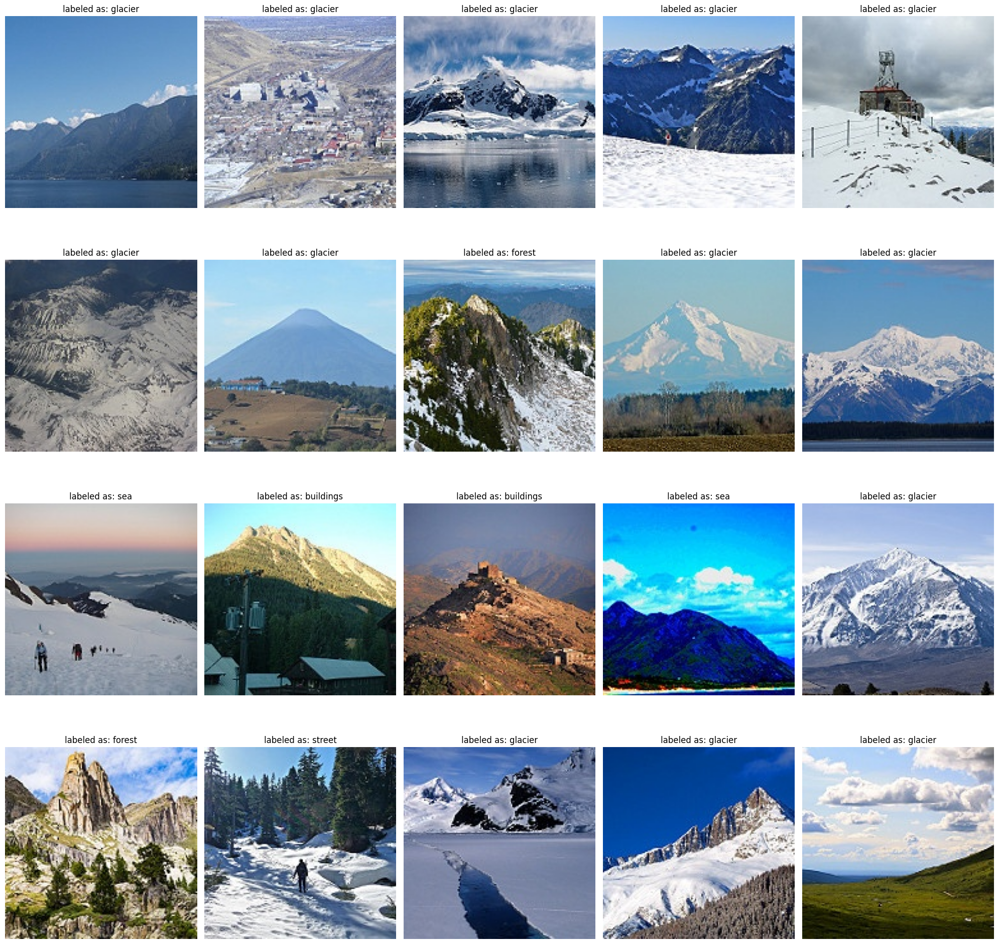

In [ ]:
import random
random_imgs = random.sample(wrong_predictions, 20)

plt.figure(figsize=(20,20))
for i, (img, label) in enumerate(random_imgs):
  plt.subplot(4, 5, i+1)
  plt.imshow(img)
  plt.title(f'labeled as: {class_names_inverse[label]}')
  plt.axis('off')
plt.tight_layout()
plt.show()

Mountains are most often misclassified as 'sea' or 'glacier'